In [1]:
import numpy as np
import xarray as xr
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import cartopy.crs as ccrs


In [2]:
%load_ext autoreload
%autoreload 2

In [20]:
from bopak import bodb, set_BOEASE2
from bopak import bodata3d

In [76]:
import matplotlib
matplotlib.rc('xtick', labelsize=16)
matplotlib.rc('ytick', labelsize=16)
matplotlib.rc('font',**{'family':'serif','variant':'small-caps'})
ftsz = 16
lw = 2

In [184]:
picdir = Path('/home/zliu/Outpics/BO/20231201/')
picfmt = 'png'
picdpi = 300

if not picdir.exists(): picdir.mkdir(parents=True,exist_ok=True)

In [7]:
BOROOT = Path('/data/BO/EASE2/combined/nc')
tdb = bodb(BOROOT,ftype='nc',freq='Y')

In [9]:
with xr.open_dataset(tdb.iloc[0].fn) as ds:
    ds.load()

In [12]:
pcproj = ccrs.PlateCarree()
mds,boprj = set_BOEASE2()

In [415]:
mon_names = pd.to_datetime(pd.Series(list(range(1,13))),format='%m').dt.strftime('%b').values

In [416]:
mlvl = levels=np.linspace(80,210,27)
flvl = levels=np.linspace(210,360,31)

In [25]:
dat07 = bodata3d(tdb.iloc[0].fn)
dat07mon = dat07.data.groupby(dat07.data.time.dt.month).mean()

In [26]:
dat07.data

<xarray.Dataset>
Dimensions:                   (X: 263, Y: 263, time: 365)
Coordinates:
  * X                         (X) float64 -3.275e+06 -3.25e+06 ... 3.275e+06
  * Y                         (Y) float64 -3.275e+06 -3.25e+06 ... 3.275e+06
  * time                      (time) datetime64[ns] 2007-01-01 ... 2007-12-31
Data variables: (12/50)
    lat                       (Y, X) float32 ...
    lon                       (Y, X) float32 ...
    insol                     (time, Y, X) float32 ...
    sic                       (time, Y, X) float32 ...
    emelt                     (Y, X) float32 ...
    fmelt                     (Y, X) float32 ...
    ...                        ...
    hthr_ice_MYI_pond         (time, Y, X) float32 ...
    hthr_ice_FYI_pond         (time, Y, X) float32 ...
    hthr_ice_AGE_pond         (time, Y, X) float32 ...
    accu_hthr_ice_MYI_pond    (time, Y, X) float32 ...
    accu_hthr_ice_FYI_pond    (time, Y, X) float32 ...
    accu_hthr_ice_AGE_pond    (time, Y, X) float32 ...

In [417]:
def plot2d(
    da,fig=None,ax=None,mds=None,prj_in=None,x_in=None,y_in=None,lvl_in=None,
    cmap='RdBu_r',XLIM=None,YLIM=None,ocn_color='c',figsize=None,factor=1.):
    if figsize is None: figsize=(8,8)
    from cartopy.feature import OCEAN 
    from cartopy.feature import LAND
    if prj_in is None or mds is None: 
        mds, prj_in = set_BOEASE2()
    if x_in is None or y_in is None:
        x_in, y_in = np.meshgrid(da.X.values, da.Y.values)
    if XLIM is None or YLIM is None:
        XLIM = mds.XLIM
        YLIM = mds.YLIM        
    if ax is None:
        fig, ax = plt.subplots(1,1,figsize=(7,7),subplot_kw=dict(projection=prj_in))
    chdl = ax.contourf(
        x_in,y_in,da*factor,
        levels=lvl_in,
        cmap=cmap,extend='both')
    ax.set_extent([-XLIM,XLIM,-YLIM,YLIM],crs=prj_in)
    ax.coastlines(color='.3')
    ax.gridlines(xlocs=np.arange(-180,180,45))
    ax.add_feature(OCEAN,color=ocn_color,alpha=.5)
    ax.add_feature(LAND,color='.6')
    return chdl, fig, ax

In [414]:
def plot_heat(vn,lvl_heat=np.linspace(0,160,33),cticks=np.linspace(0,160,17),txt_unit=r'[W/m$^2$]',txt_var=None,factor=1.,cmap='RdBu_r'):
    if txt_var is None: txt_var = vn
    chdls = []
    fig, axs = plt.subplots(4,3,figsize=(10,12),subplot_kw=dict(projection=boprj),sharex=True,sharey=True)
    for ii,i_mon in enumerate([11]+list(range(11))):
        irow = ii//3
        icol = ii%3
        txt_mon = mon_names[i_mon]
        ax = axs[irow,icol]
        dat_mon = dat07mon[vn][i_mon]
        chdl,_,_=plot2d(dat_mon,fig=fig,ax=ax,mds=mds,prj_in=boprj,lvl_in=lvl_heat,factor=factor,cmap=cmap)
        chdls.append(chdl)
        ax.set_title(f'{txt_mon}',fontsize=ftsz)

    fig.subplots_adjust(wspace=-.1,hspace=.2,top=.92,bottom=.03,left=.05,right=.90)
    cax = fig.add_axes([.9,.02,.03,.9])
    cb = fig.colorbar(chdls[0],ax=ax,cax=cax)
    cb.ax.set_title(txt_unit,fontsize=ftsz-2)
    cb.set_ticks(cticks)
    fig.suptitle(f'{txt_var}: {dat07.year}',fontsize=ftsz);
    return fig, axs, chdls

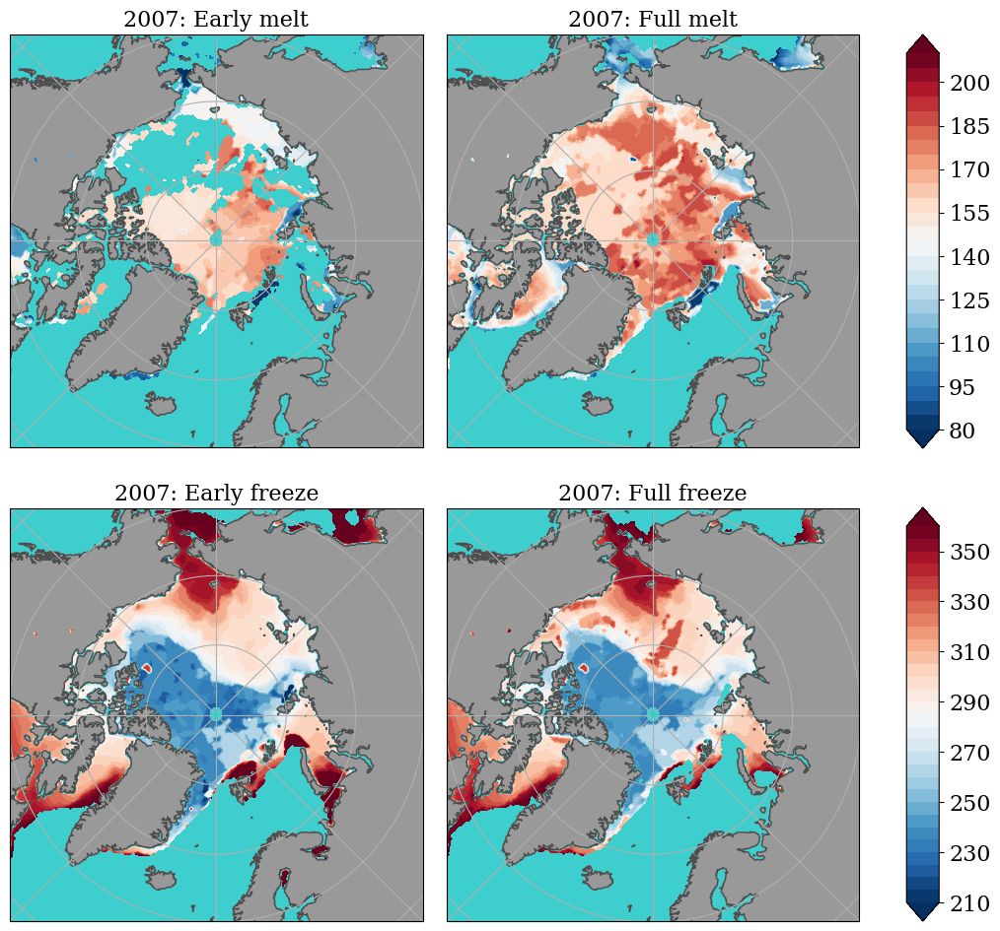

In [189]:
# --- plot onset dates ----
ds = dat07.data
vns = ['emelt','fmelt','efreeze','ffreeze']
ttls = ['Early melt','Full melt','Early freeze', 'Full freeze']
yr_txt = str(dat07.year)
chdls = []
fig, axs = plt.subplots(2,2,figsize=(11,10),subplot_kw=dict(projection=boprj),sharex=True,sharey=True)
for ivn, vn in enumerate(vns):
    irow = ivn//2
    icol = ivn%2
    ax = axs[irow,icol]
    lvls = mlvl if 'melt' in vn else flvl
    chdl,_,_=plot2d(ds[vn],fig=fig,ax=ax,mds=mds,prj_in=boprj,lvl_in=lvls)
    chdls.append(chdl)
    ax.set_title(f'{yr_txt}: {ttls[ivn]}',fontsize=ftsz)
fig.subplots_adjust(wspace=-.1,hspace=.15,top=.95,bottom=.05,left=.05,right=.90)
cax = fig.add_axes([.91,.53,.03,.42])
fig.colorbar(chdls[0],ax=ax,cax=cax)
cax = fig.add_axes([.91,.05,.03,.42])
fig.colorbar(chdls[2],ax=ax,cax=cax)
picfn = picdir/f'onset_dates_{yr_txt}.{picfmt}'
fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

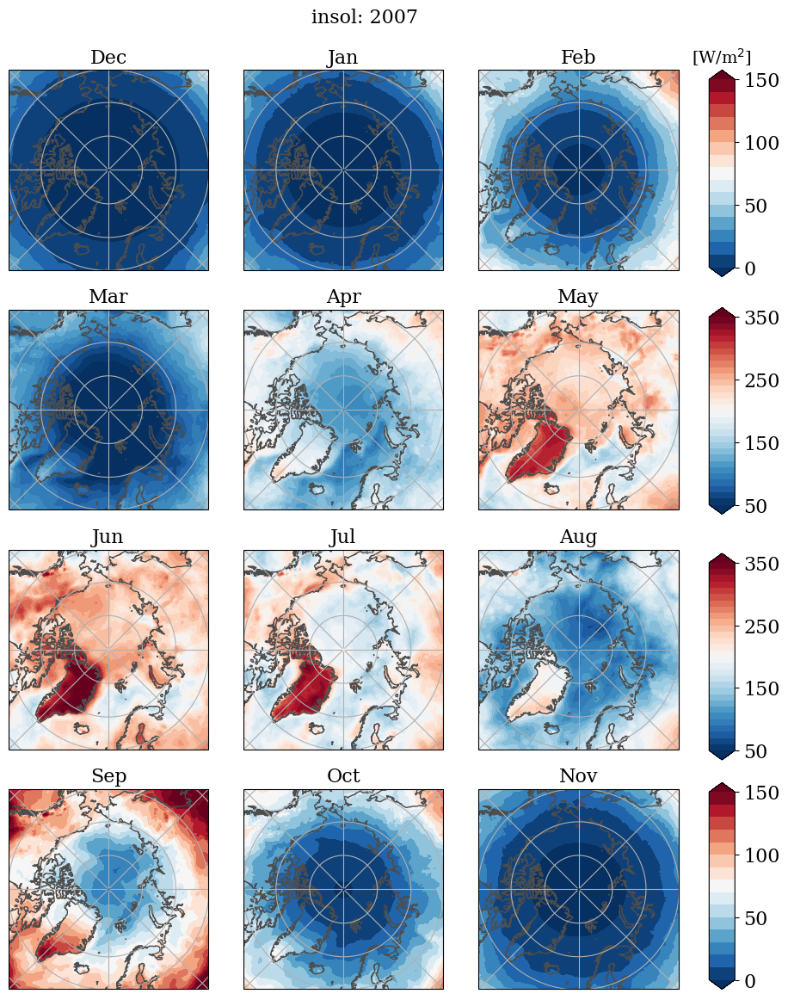

In [190]:
# --- plot insol by month
chdls = []
vn = 'insol'
lvl_insol_DJF = np.linspace(0,150,16)
lvl_insol_MAM = np.linspace(50,350,31)
lvl_insol_JJA = np.linspace(50,350,31)
lvl_insol_SON = np.linspace(0,150,16)
lvl_dict = {0:lvl_insol_DJF,1:lvl_insol_MAM,2:lvl_insol_JJA,3:lvl_insol_SON}
fig, axs = plt.subplots(4,3,figsize=(10,12),subplot_kw=dict(projection=boprj),sharex=True,sharey=True)
for ii,i_mon in enumerate([11]+list(range(11))):
    irow = ii//3
    icol = ii%3
    txt_mon = mon_names[i_mon]
    ax = axs[irow,icol]
    dat_mon = dat07mon[vn][i_mon]
    chdl,_,_=plot2d(dat_mon,fig=fig,ax=ax,mds=mds,prj_in=boprj,lvl_in=lvl_dict[irow])
    chdls.append(chdl)
    ax.set_title(f'{txt_mon}',fontsize=ftsz)

fig.subplots_adjust(wspace=-.1,hspace=.2,top=.92,bottom=.03,left=.05,right=.90)
cax = fig.add_axes([.9,.72,.03,.2])
cb = fig.colorbar(chdls[0],ax=ax,cax=cax)
cb.ax.set_title(r'[W/m$^2$]',fontsize=ftsz-2)
cb.set_ticks([0,50,100,150])
cax = fig.add_axes([.9,.49,.03,.2])
cb = fig.colorbar(chdls[3],ax=ax,cax=cax)
cb.set_ticks([50,150,250,350])
cax = fig.add_axes([.9,.252,.03,.2])
cb = fig.colorbar(chdls[6],ax=ax,cax=cax)
cb.set_ticks([50,150,250,350])
cax = fig.add_axes([.9,.03,.03,.2])
cb = fig.colorbar(chdls[9],ax=ax,cax=cax)
cb.set_ticks([0,50,100,150])
fig.suptitle(f'{vn}: {dat07.year}',fontsize=ftsz);
picfn = picdir/f'{vn}_{yr_txt}.{picfmt}'
fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')



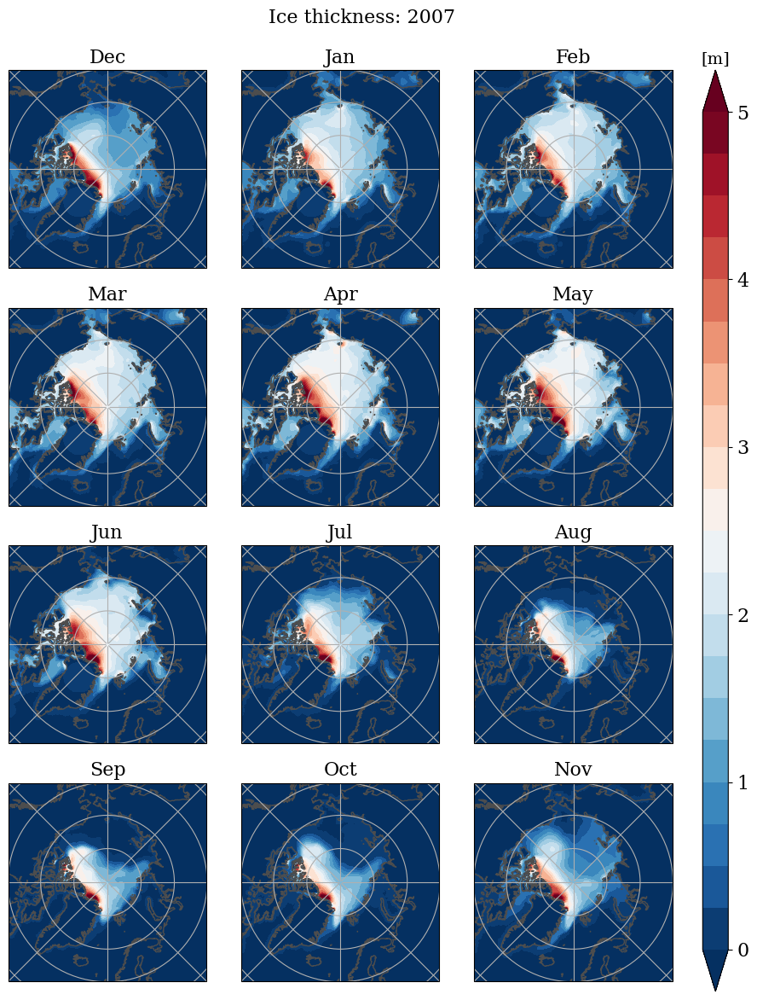

In [393]:
# --- plot sea ice thickness
vn = 'sith'
fig, axs, chdls = plot_heat(vn,lvl_heat=lvl_sith,cticks=np.arange(6),txt_unit='[m]',txt_var='Ice thickness')
# picfn = picdir/f'{vn}_{yr_txt}.{picfmt}'
# fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

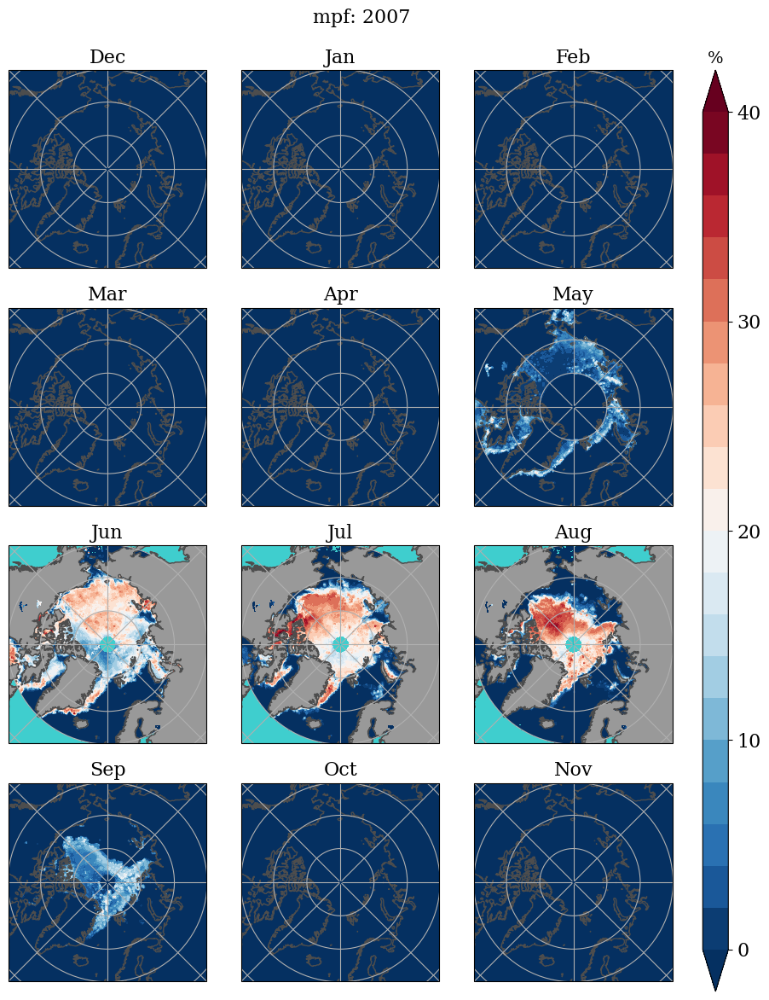

In [398]:
vn = 'mpf'
lvl_mpf = np.linspace(0,40,21)
fig, axs,chdls = plot_heat(vn,lvl_heat=lvl_mpf,cticks=np.linspace(0,40,5),txt_unit='%',factor=100,)
# picfn = picdir/f'{vn}_{yr_txt}.{picfmt}'
# fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

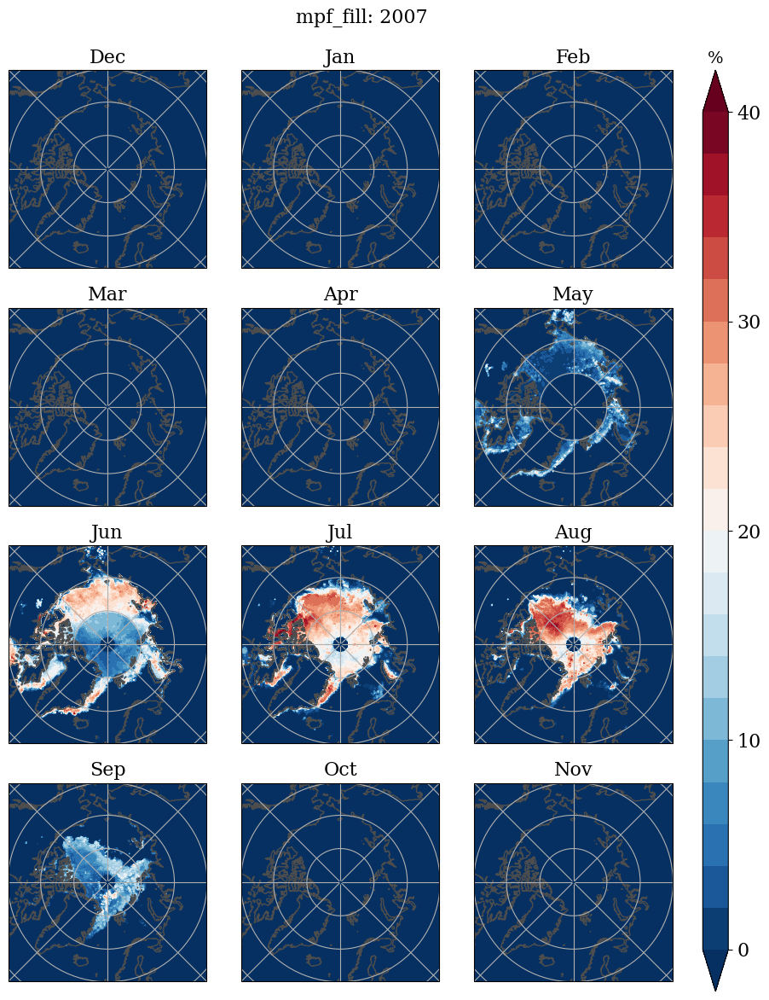

In [400]:
vn = 'mpf_fill'
lvl_mpf = np.linspace(0,40,21)
fig, axs,chdls = plot_heat(vn,lvl_heat=lvl_mpf,cticks=np.linspace(0,40,5),txt_unit='%',factor=100,)
picfn = picdir/f'{vn}_{yr_txt}.{picfmt}'
fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

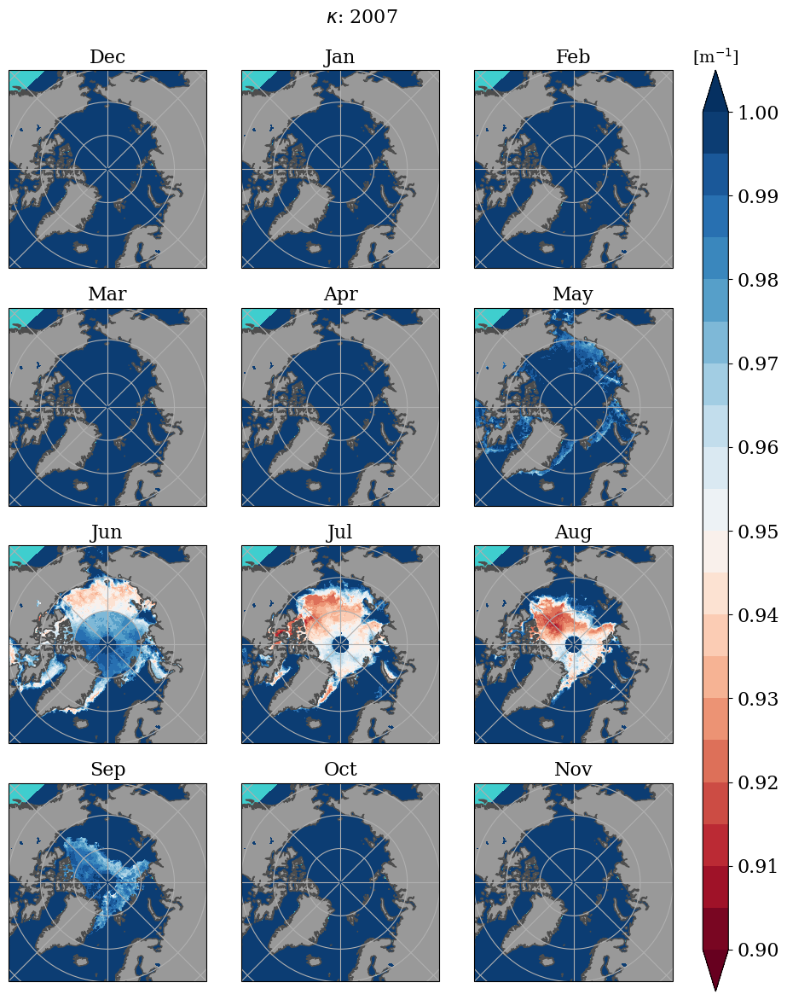

In [406]:
vn = 'kappa'
lvl_kappa = np.linspace(.9,1,21)
fig, axs, chdls = plot_heat(vn,lvl_heat=lvl_kappa,cticks=np.linspace(.9,1,11),txt_unit=r'[m$^{-1}$]',txt_var=r'$\kappa$',cmap='RdBu')
picfn = picdir/f'{vn}_{yr_txt}.{picfmt}'
fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

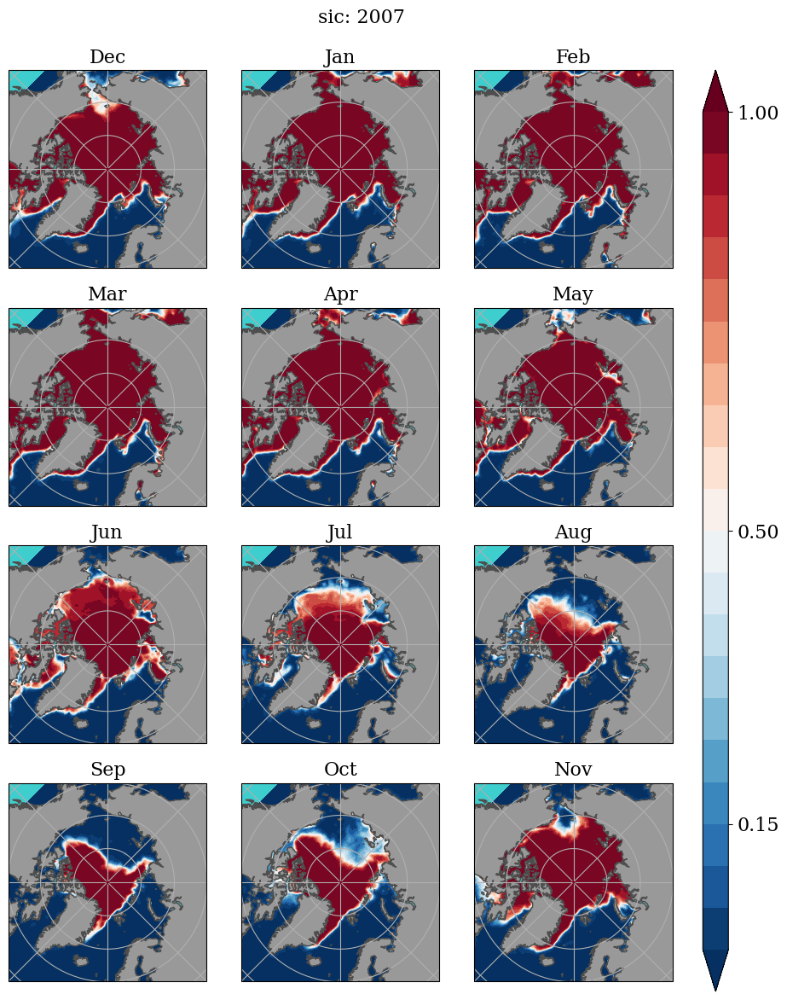

In [408]:
vn = 'sic'
lvl_sic = np.linspace(0,1,21)
fig, axs, chdls = plot_heat(vn,lvl_heat=lvl_sic,cticks=[.15,.5,1.],txt_unit='')
# picfn = picdir/f'{vn}_{yr_txt}.{picfmt}'
# fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

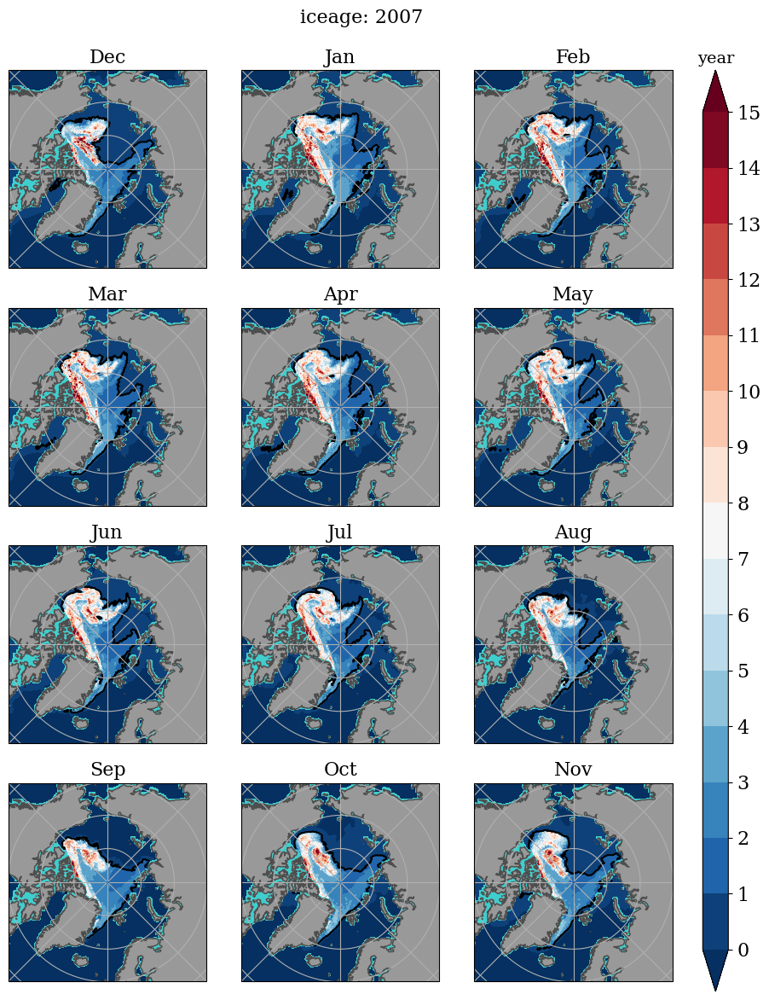

In [412]:
vn = 'iceage'
lvl_ia = np.linspace(0,15,16)
fig, axs, chdls = plot_heat(vn,lvl_heat=lvl_ia,cticks=np.linspace(0,15,16),txt_unit='year',)
for ii,i_mon in enumerate([11]+list(range(11))):
    irow = ii//3
    icol = ii%3
    ax = axs[irow,icol]
    dat_mon = dat07mon[vn][i_mon]
    ax.contour(xx,yy,dat_mon,levels=[1],colors='k')
# picfn = picdir/f'{vn}_{yr_txt}.{picfmt}'
# fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

In [244]:
def plot_albedo(vn):
    chdls = []
    lvl_alb = np.linspace(.1,.85,26)
    lvl_dict = {0:lvl_insol_DJF,1:lvl_insol_MAM,2:lvl_insol_JJA,3:lvl_insol_SON}
    fig, axs = plt.subplots(4,3,figsize=(10,12),subplot_kw=dict(projection=boprj),sharex=True,sharey=True)
    for ii,i_mon in enumerate([11]+list(range(11))):
        irow = ii//3
        icol = ii%3
        txt_mon = mon_names[i_mon]
        ax = axs[irow,icol]
        dat_mon = dat07mon[vn][i_mon]
        chdl,_,_=plot2d(dat_mon,fig=fig,ax=ax,mds=mds,prj_in=boprj,lvl_in=lvl_alb)
        chdls.append(chdl)
        ax.set_title(f'{txt_mon}',fontsize=ftsz)

    fig.subplots_adjust(wspace=-.1,hspace=.2,top=.92,bottom=.03,left=.05,right=.90)
    cax = fig.add_axes([.9,.02,.03,.9])
    cb = fig.colorbar(chdls[0],ax=ax,cax=cax)
    cb.set_ticks(np.linspace(.1,.85,6))
    fig.suptitle(f'{vn}: {dat07.year}',fontsize=ftsz);
    return fig, axs, chdls
    

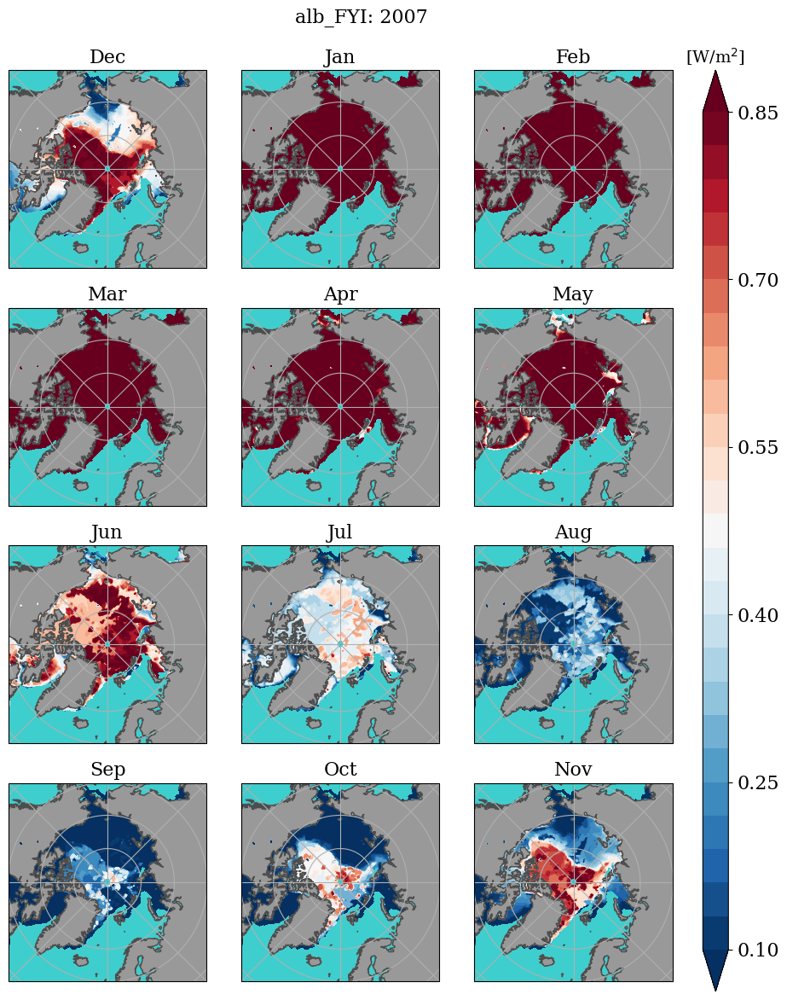

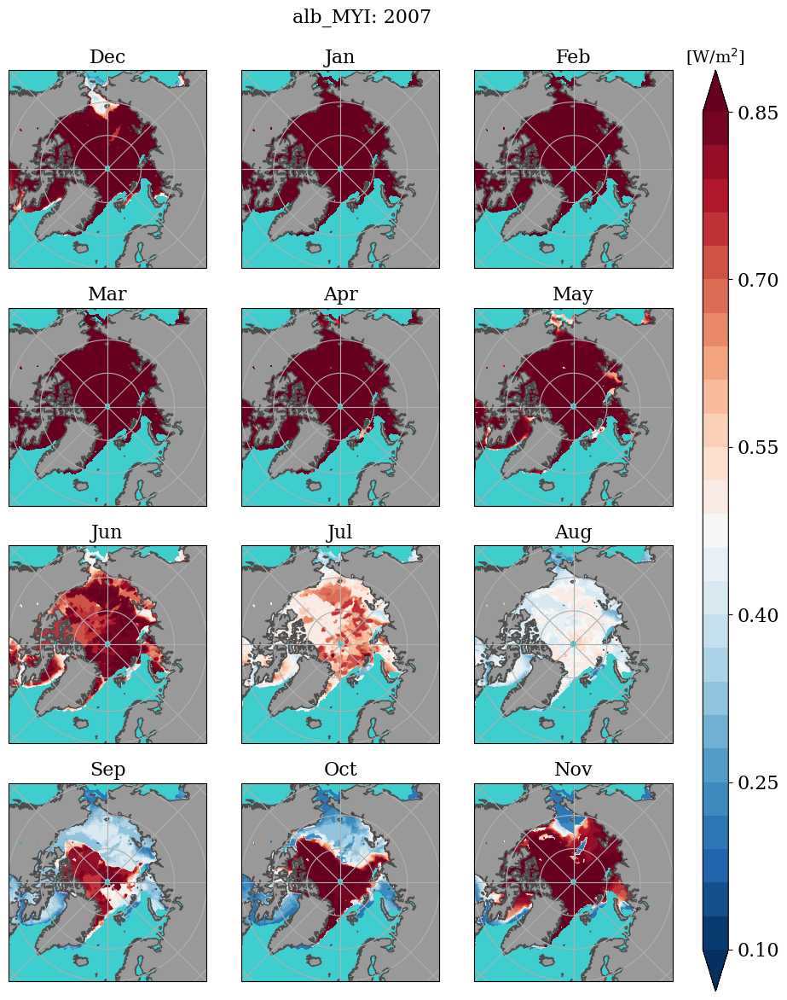

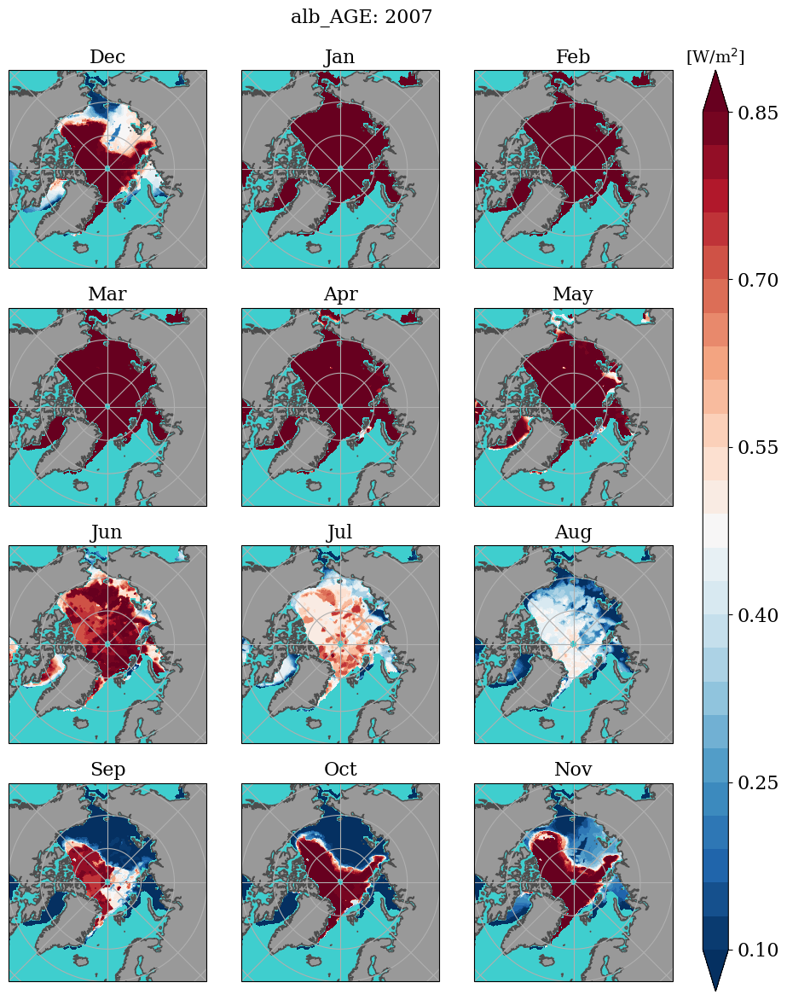

In [418]:
lvl_alb = np.linspace(.1,.85,26)
for vn in ['alb_FYI','alb_MYI','alb_AGE']:
    fig,axs,chdls = plot_heat(vn,lvl_heat=lvl_alb,cticks=np.linspace(.1,.85,6))
    # picfn = picdir/f'{vn}_{yr_txt}.{picfmt}'
    # fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

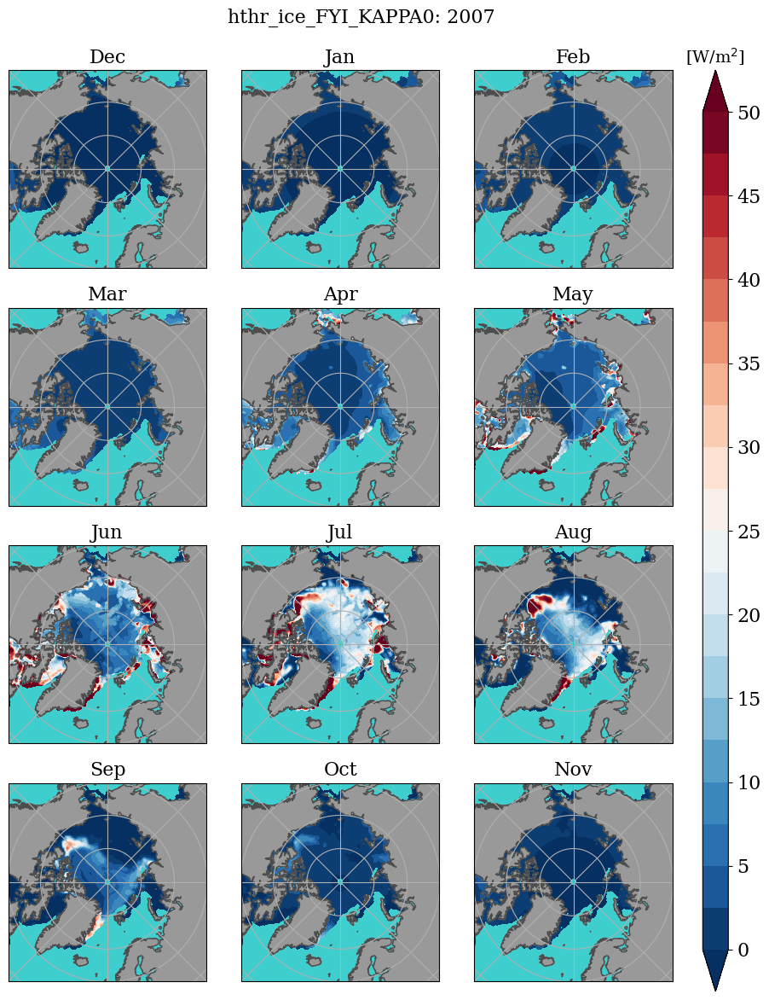

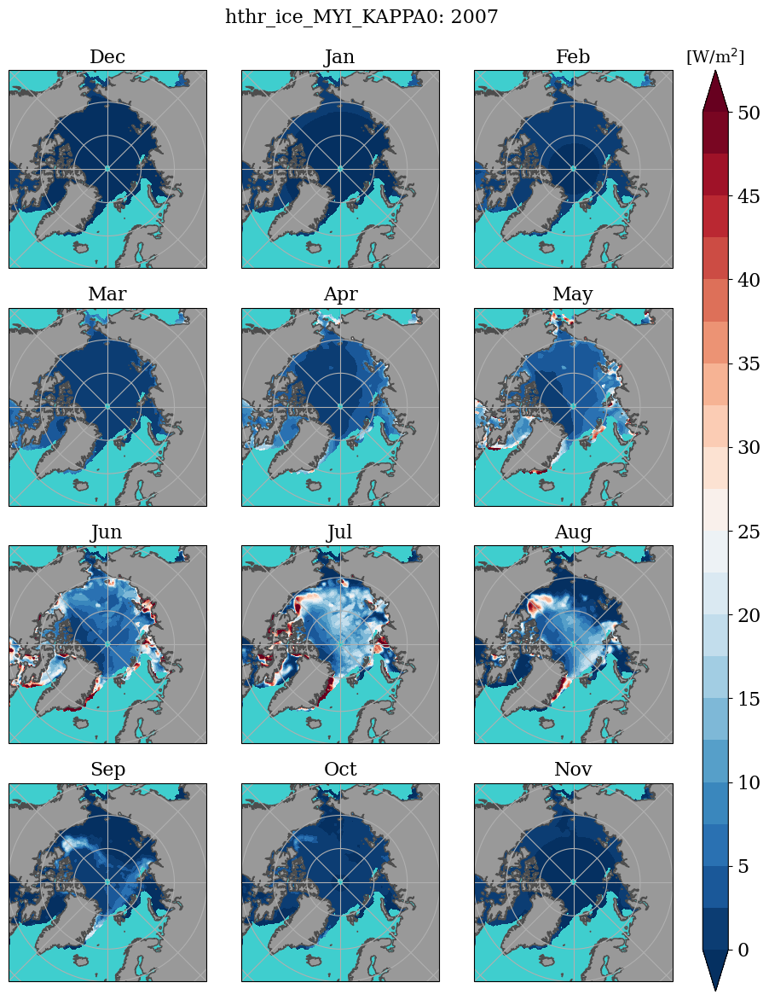

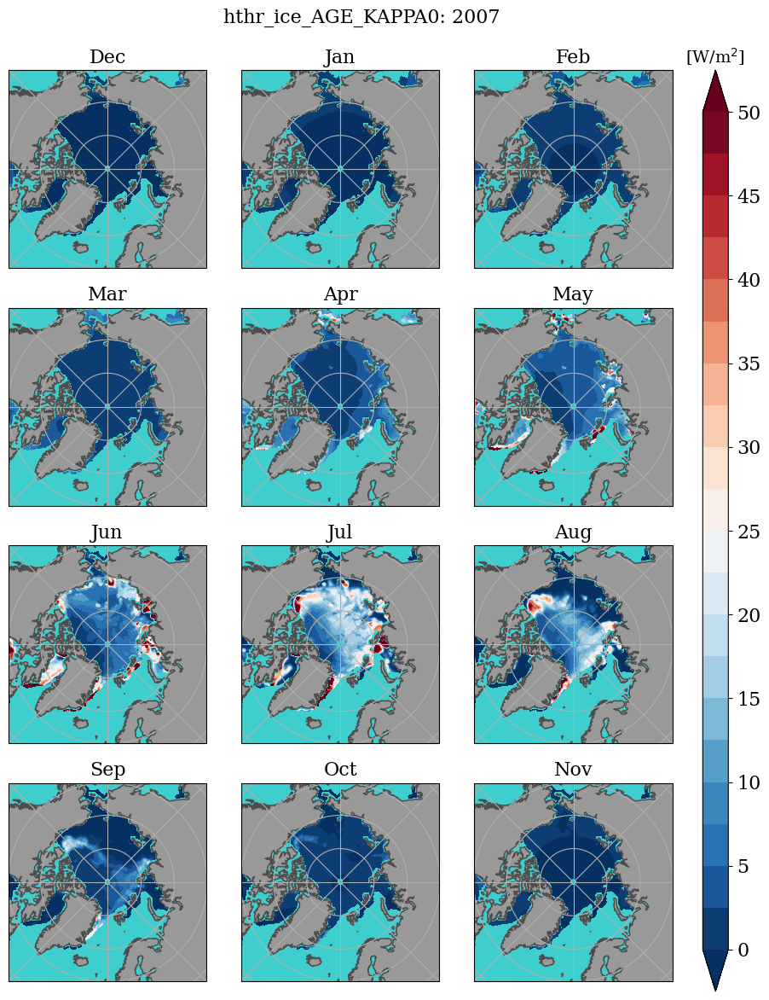

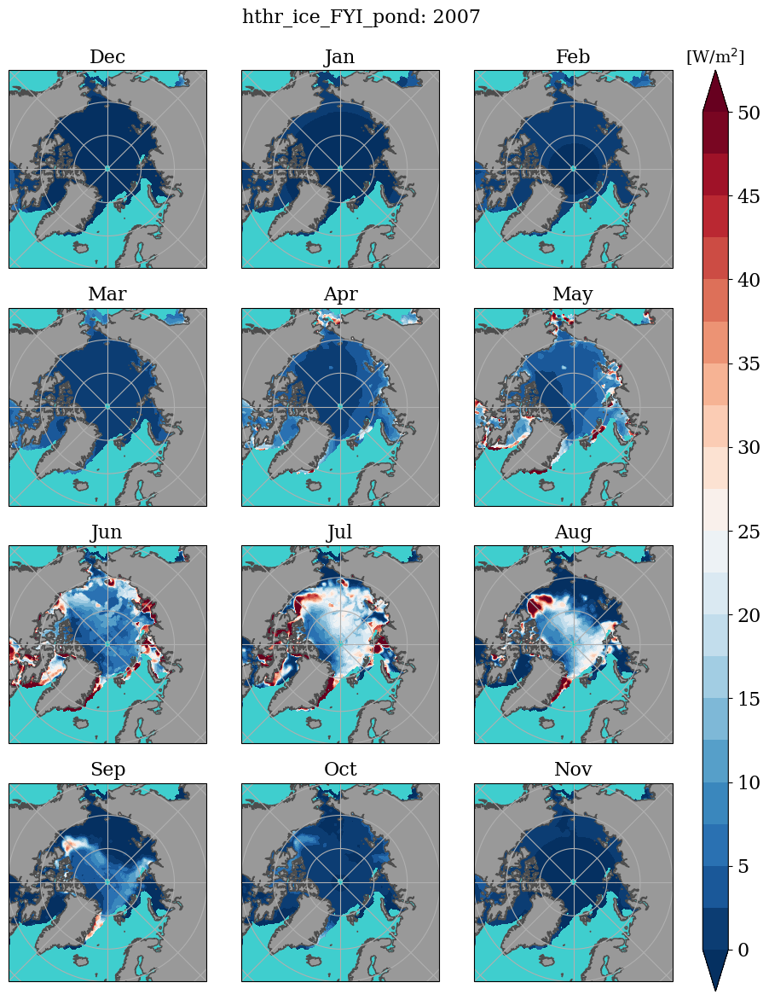

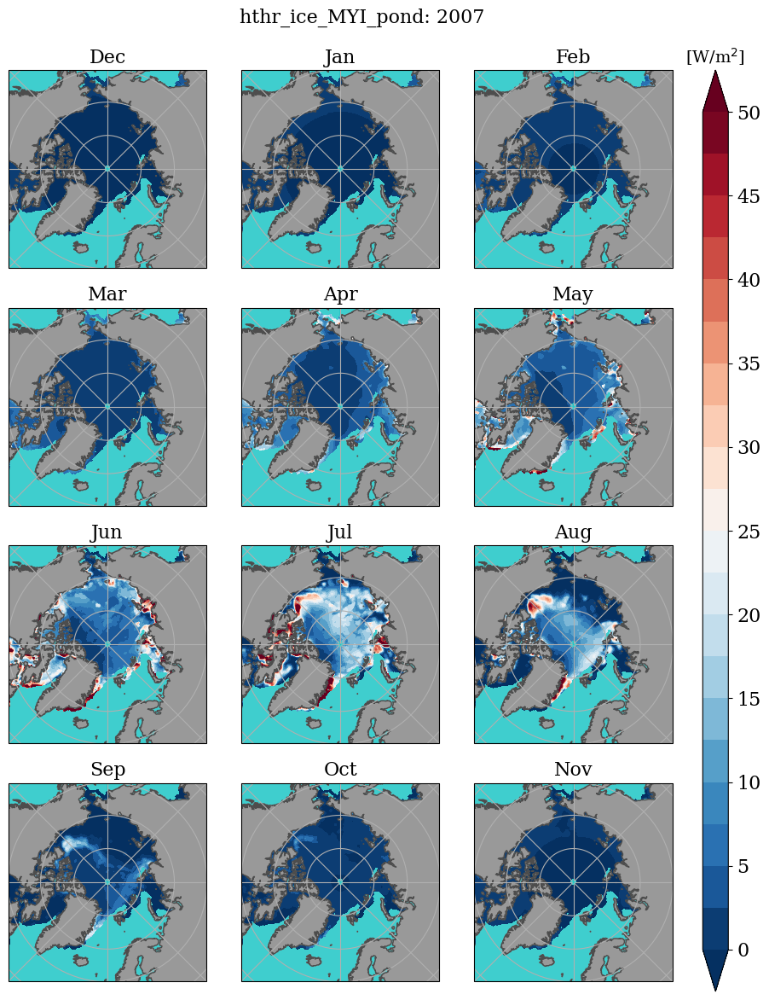

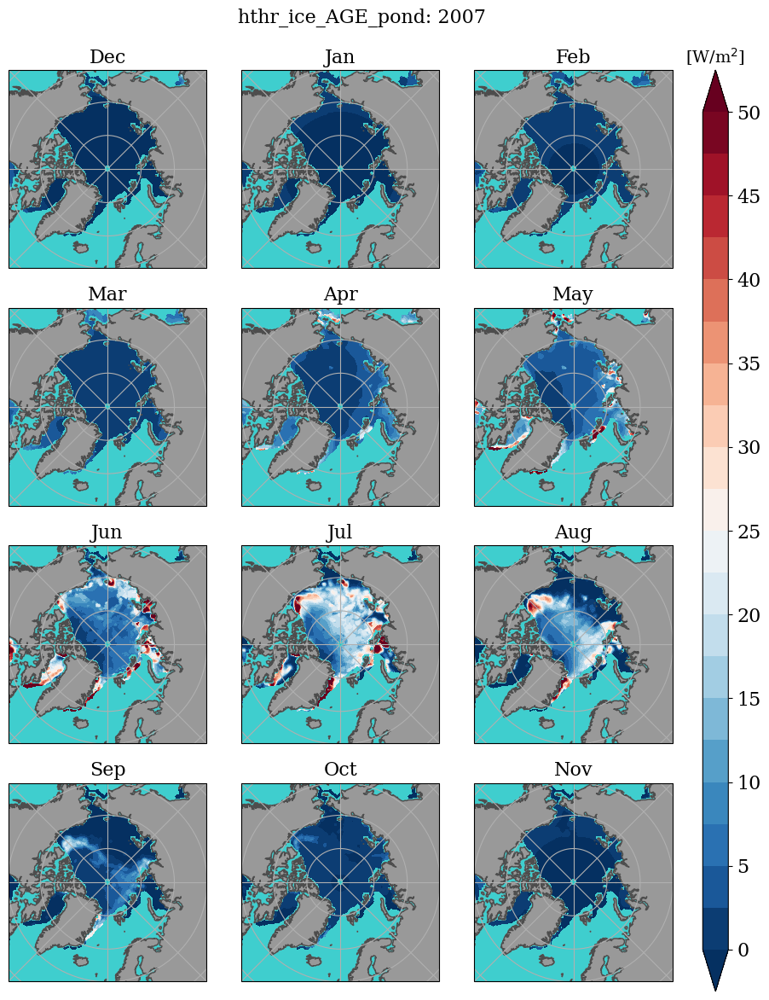

In [292]:
for vn in [
    'hthr_ice_FYI_KAPPA0','hthr_ice_MYI_KAPPA0','hthr_ice_AGE_KAPPA0',
    'hthr_ice_FYI_pond','hthr_ice_MYI_pond','hthr_ice_AGE_pond',
]:
    lvl_hthr = np.linspace(0,50,21)
    fig, axs, chdls = plot_heat(vn,lvl_heat=lvl_hthr,cticks=np.linspace(0,50,11))
    picfn = picdir/f'{vn}_{yr_txt}.{picfmt}'
    fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

In [340]:
def plot_dhthr_ratio(
    datmon,alb_type,vn_pre = 'hthr',
    clvl=np.linspace(0,40,21),cticks=np.linspace(0,40,9),txt_unit='[%]',txt_var=None):
    '''
    '''
    txt_kappa0 = r'$\kappa_0$'
    if txt_var is None: txt_var = f'$\Delta${vn_pre}_ice_{alb_type} ratio (pond-{txt_kappa0})/{txt_kappa0}'
    vn0 = f'{vn_pre}_ice_{alb_type}_KAPPA0'
    vn1 = f'{vn_pre}_ice_{alb_type}_pond'
    chdls = []
    fig, axs = plt.subplots(4,3,figsize=(10,12),subplot_kw=dict(projection=boprj),sharex=True,sharey=True)
    for ii,i_mon in enumerate([11]+list(range(11))):
        irow = ii//3
        icol = ii%3
        txt_mon = mon_names[i_mon]
        ax = axs[irow,icol]
        dat = (datmon[vn1][i_mon]-datmon[vn0][i_mon])/datmon[vn0][i_mon]*100
        chdl,_,_=plot2d(dat,fig=fig,ax=ax,mds=mds,prj_in=boprj,lvl_in=clvl)
        chdls.append(chdl)
        ax.set_title(f'{txt_mon}',fontsize=ftsz)

    fig.subplots_adjust(wspace=-.1,hspace=.2,top=.92,bottom=.03,left=.05,right=.90)
    cax = fig.add_axes([.9,.02,.03,.9])
    cb = fig.colorbar(chdls[0],ax=ax,cax=cax)
    cb.ax.set_title(txt_unit,fontsize=ftsz-2)
    cb.set_ticks(cticks)
    fig.suptitle(f'{txt_var}: {dat07.year}',fontsize=ftsz);
    return fig, axs, chdls

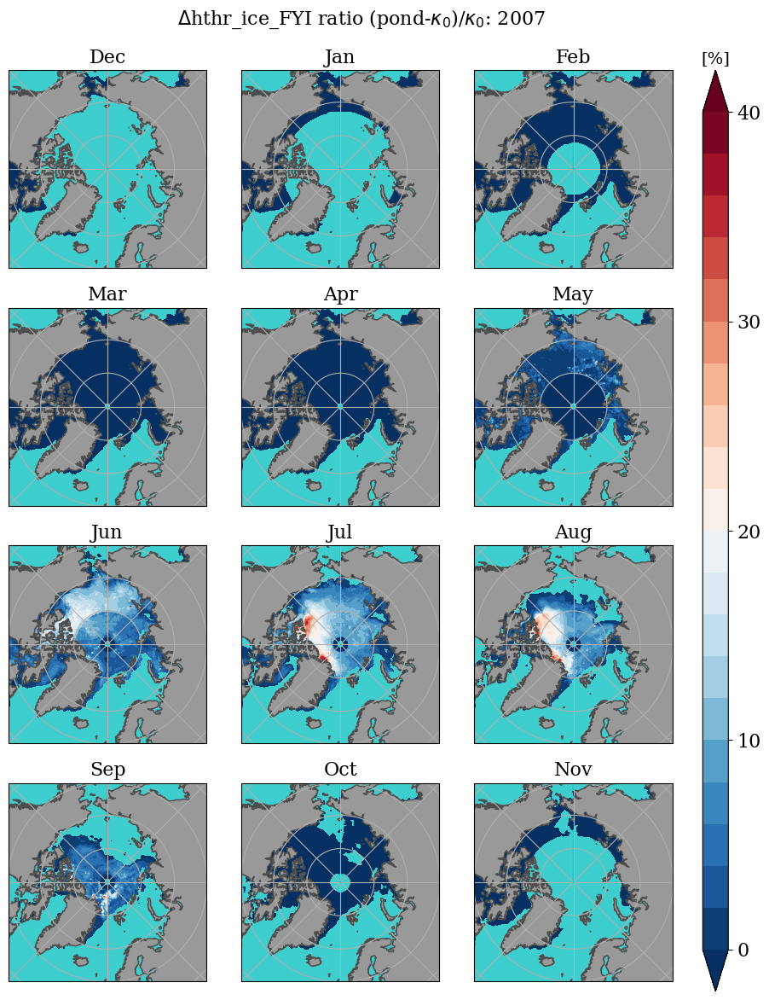

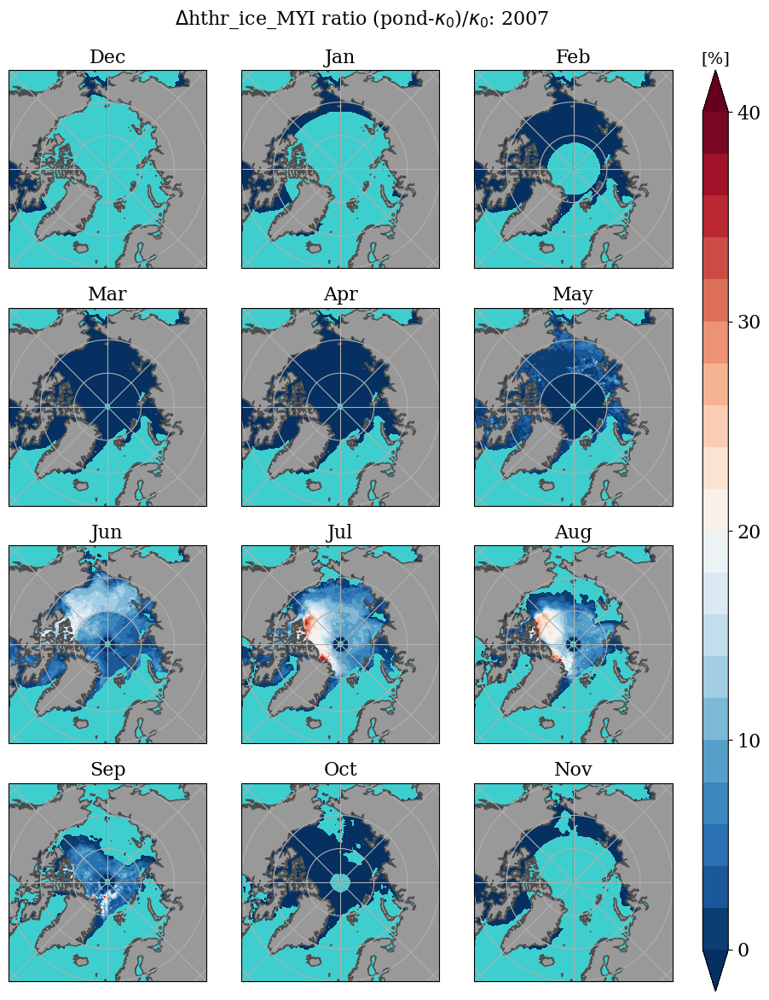

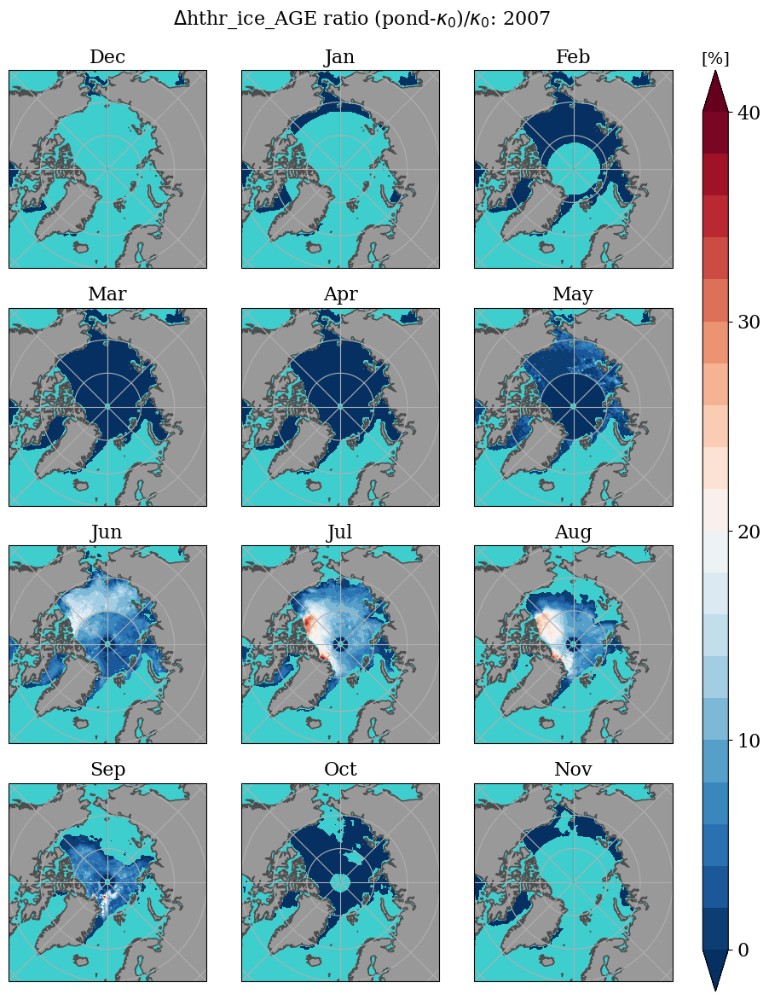

In [344]:
# --- plot heatflux through ice difference between kappa0 and pond
for alb_type in ['FYI','MYI','AGE']:
    fig, axs, chdls = plot_dhthr_ratio(dat07mon,alb_type,clvl=np.linspace(0,40,21),cticks=np.linspace(0,40,5))
    picfn = picdir/f'd_hthr_ice_{alb_type}_ratio_{yr_txt}.{picfmt}'
    fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

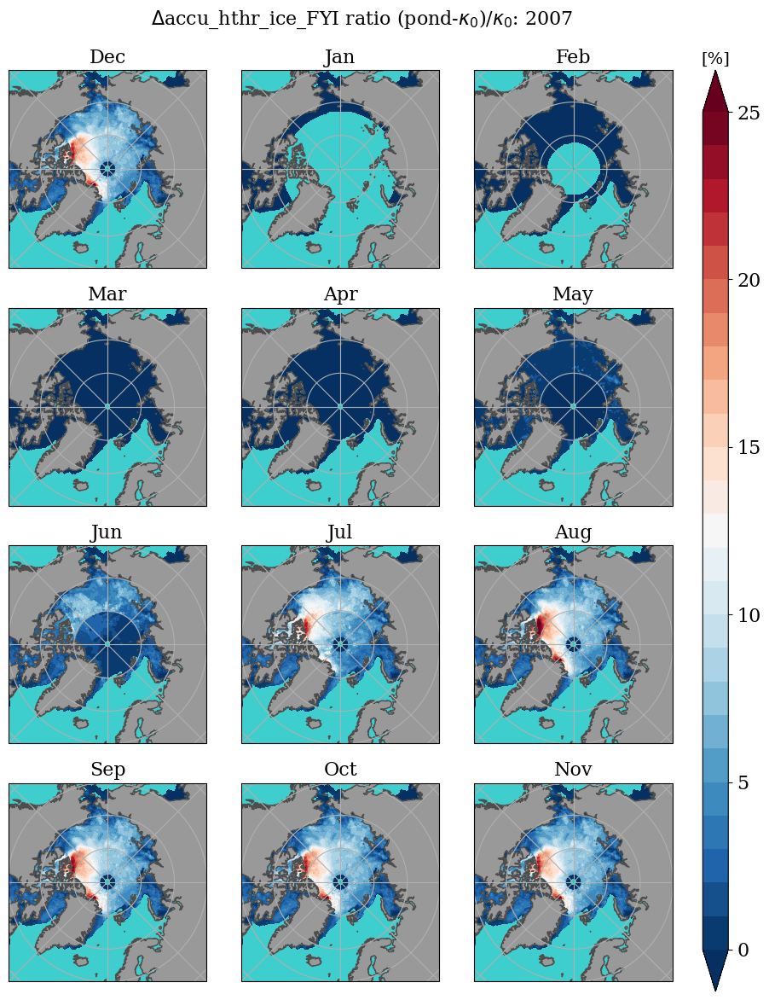

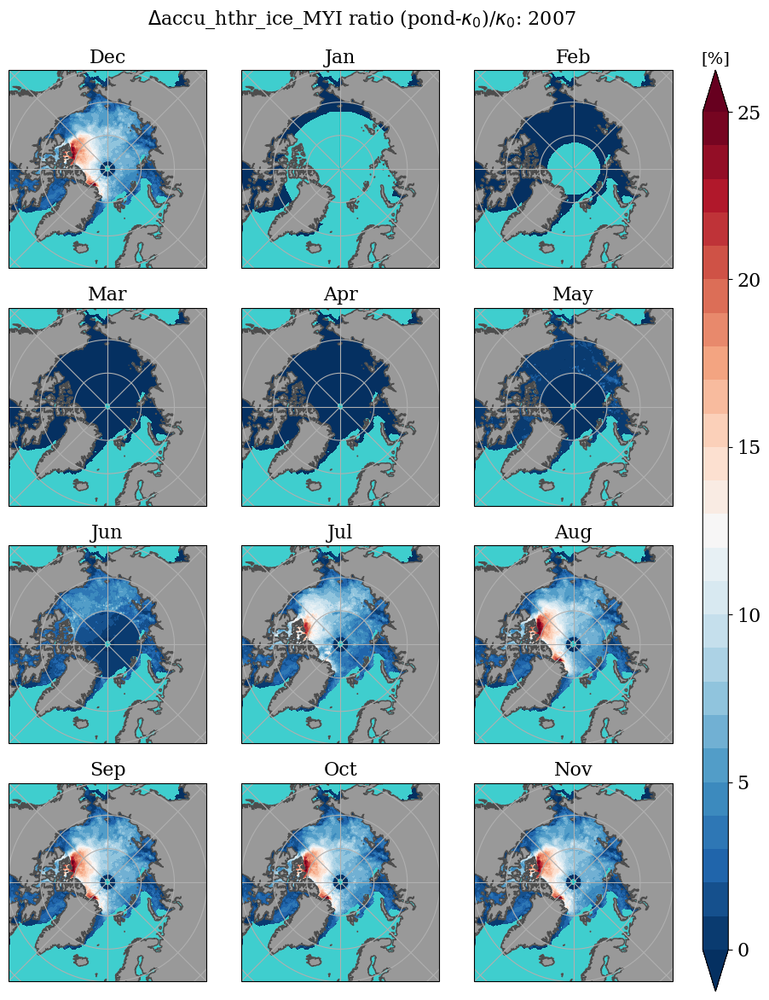

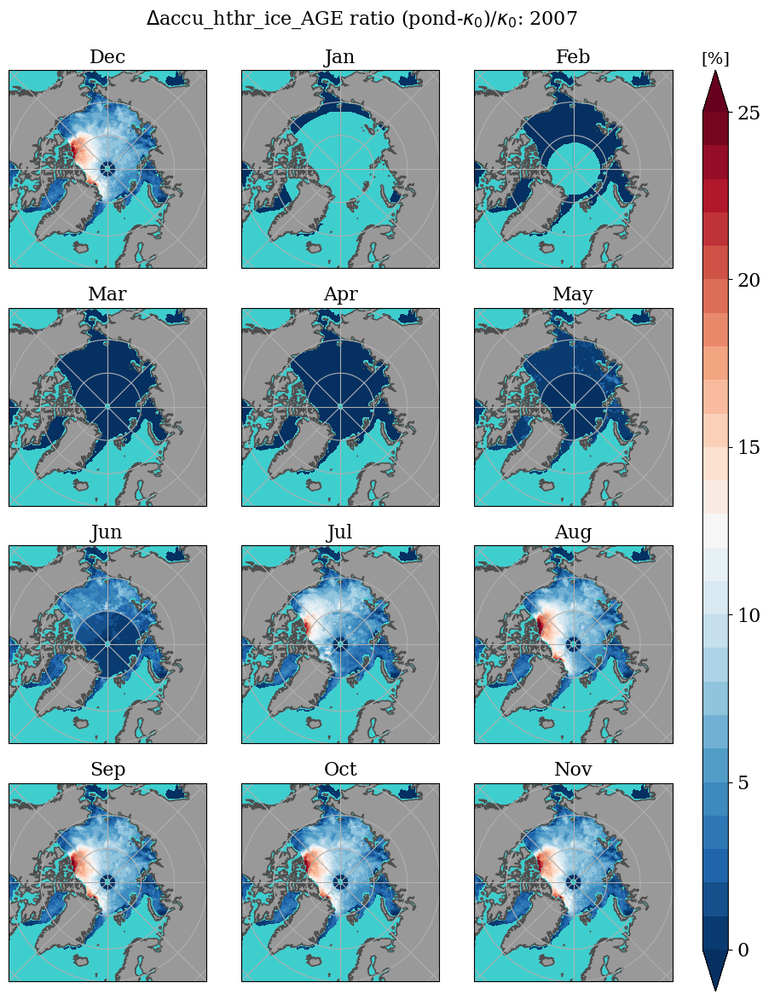

In [343]:
# --- plot accumulated heatflux through ice difference between kappa0 and pond
for alb_type in ['FYI','MYI','AGE']:
    fig, axs, chdls = plot_dhthr_ratio(dat07mon,alb_type,vn_pre='accu_hthr',clvl=np.linspace(0,25,26),cticks=np.linspace(0,25,6))
    picfn = picdir/f'd_accu_hthr_ice_{alb_type}_ratio_{yr_txt}.{picfmt}'
    fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

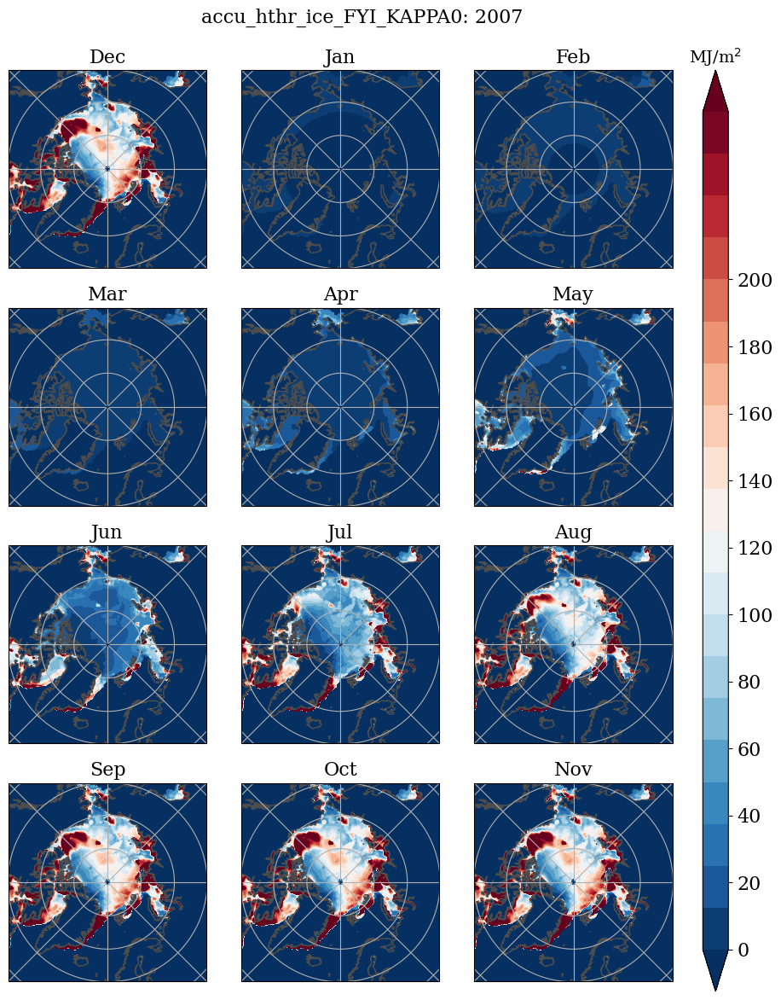

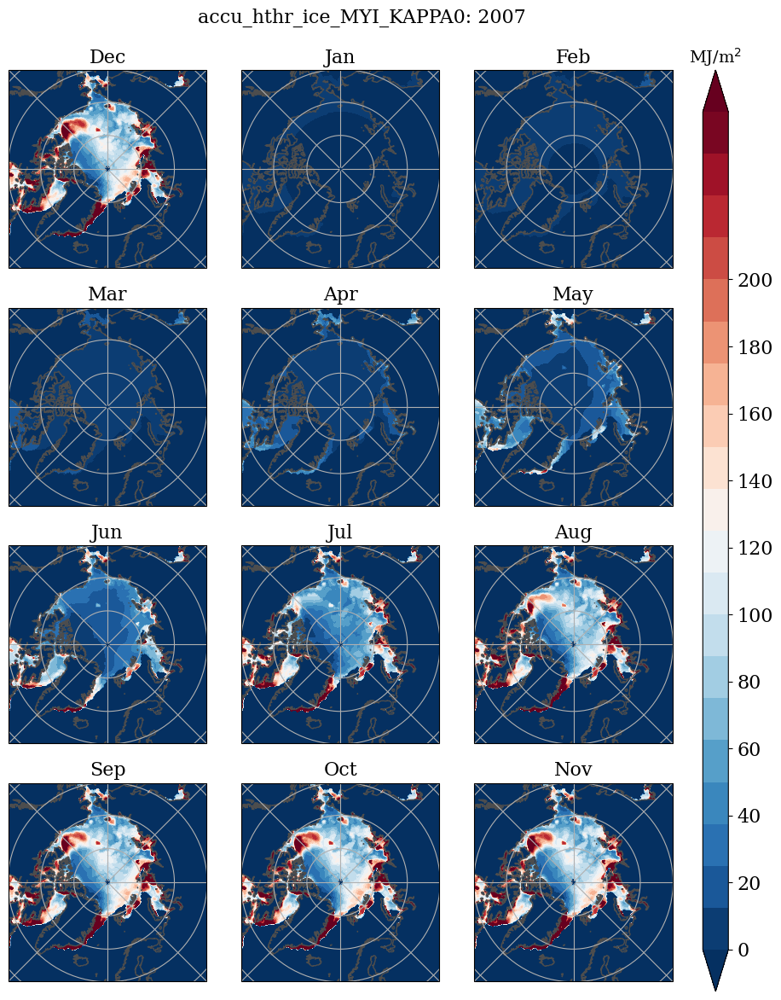

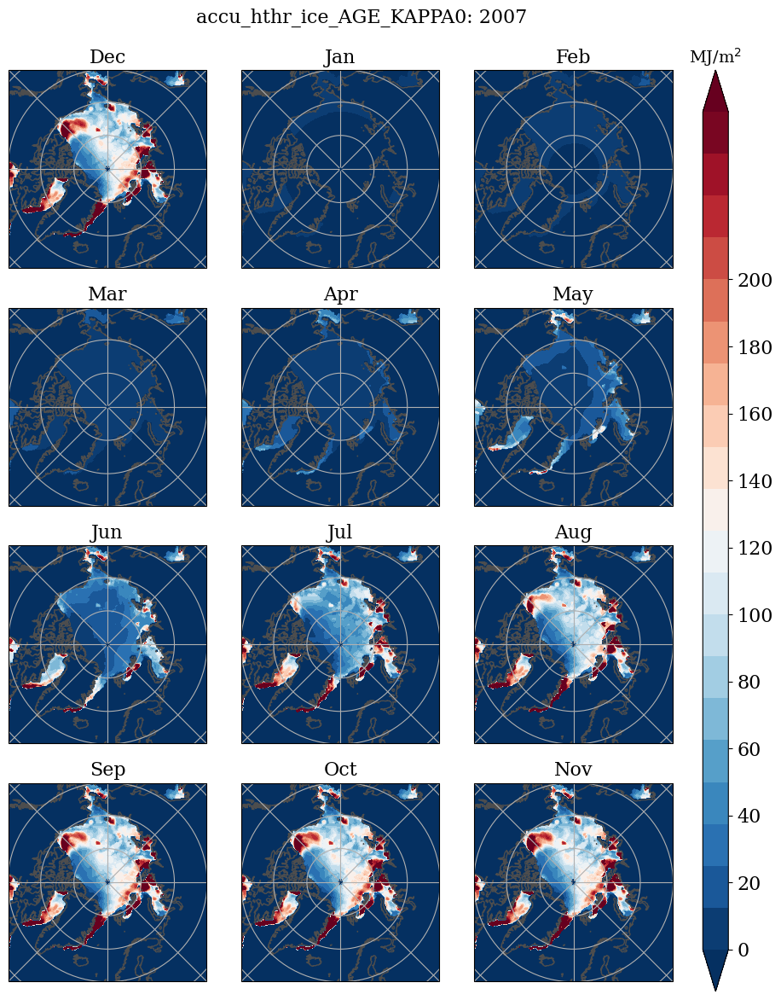

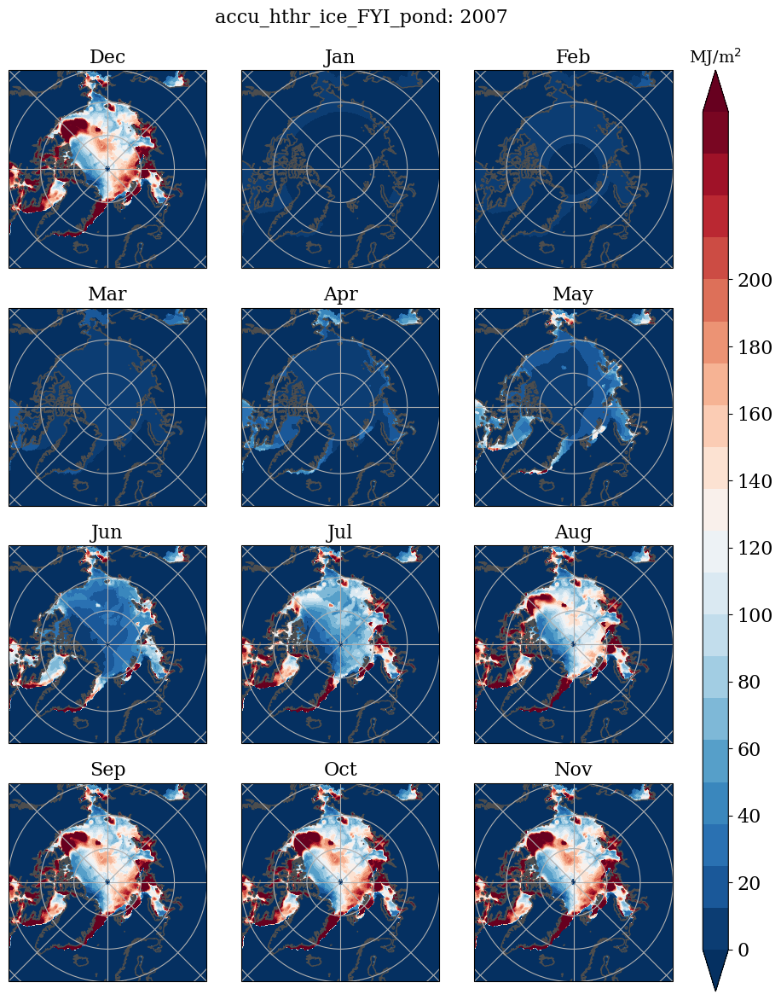

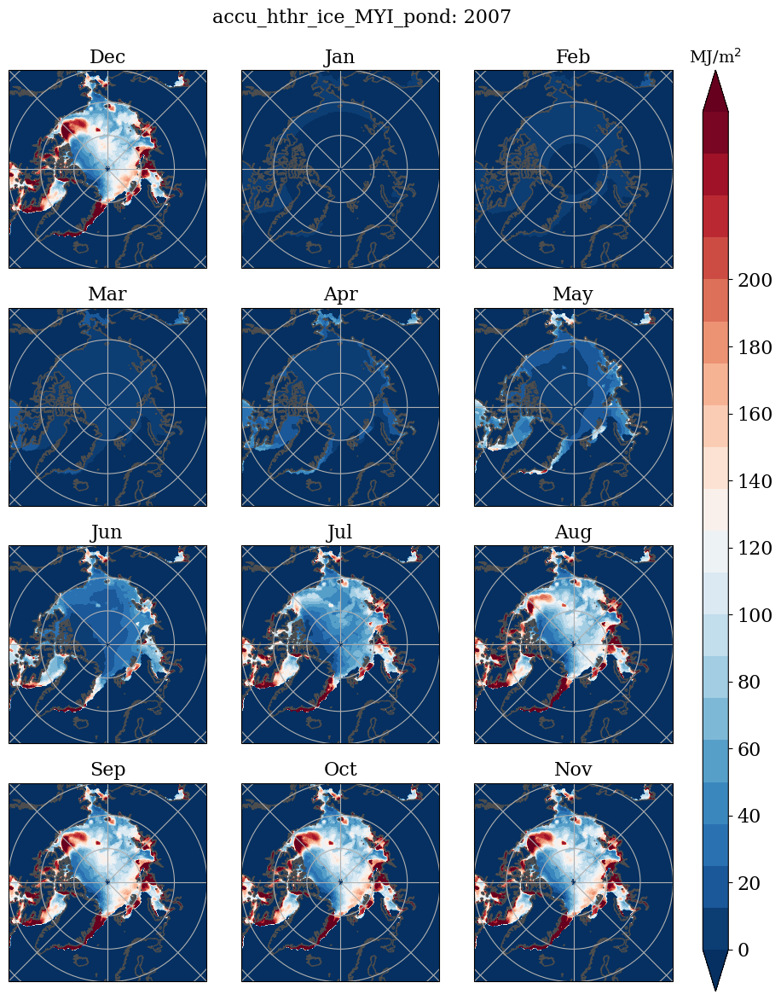

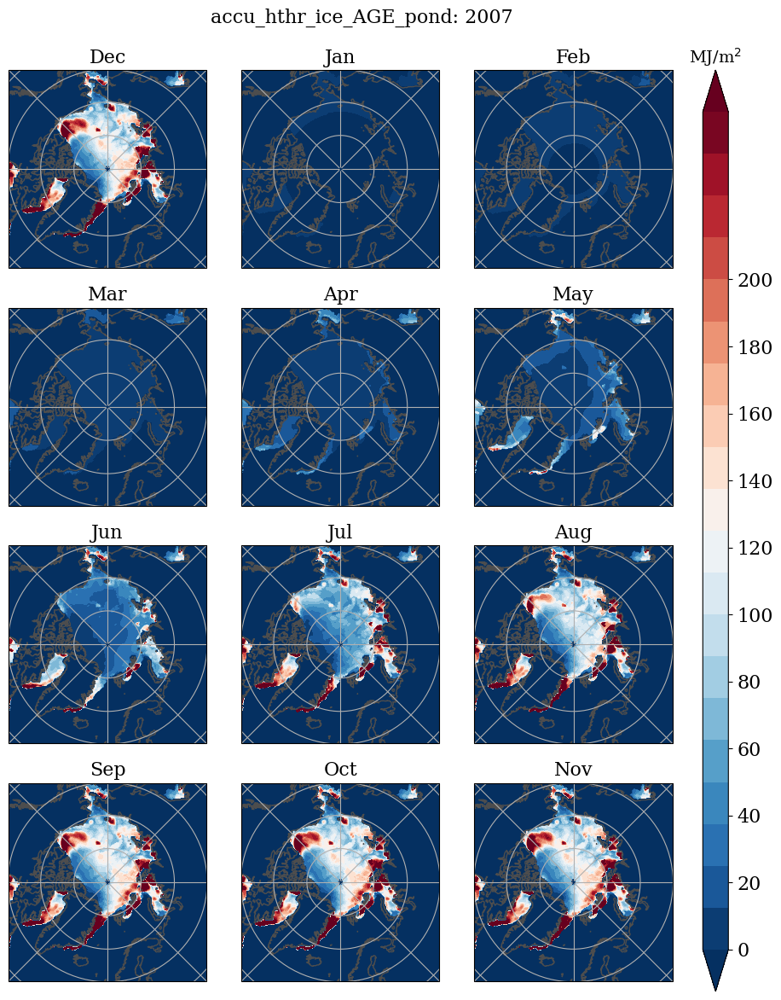

In [362]:
# --- plot accumulated heat through ice 
for vn_core in  [
    'hthr_ice_FYI_KAPPA0','hthr_ice_MYI_KAPPA0','hthr_ice_AGE_KAPPA0',
    'hthr_ice_FYI_pond','hthr_ice_MYI_pond','hthr_ice_AGE_pond',]:
    vn = f'accu_{vn_core}'
    fig, axs, chdls = plot_heat(vn,lvl_heat=np.linspace(0,250,21),cticks=np.linspace(0,200,11),txt_unit=r'MJ/m$^2$')
    picfn = picdir/f'{vn}_{yr_txt}.{picfmt}'
    fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

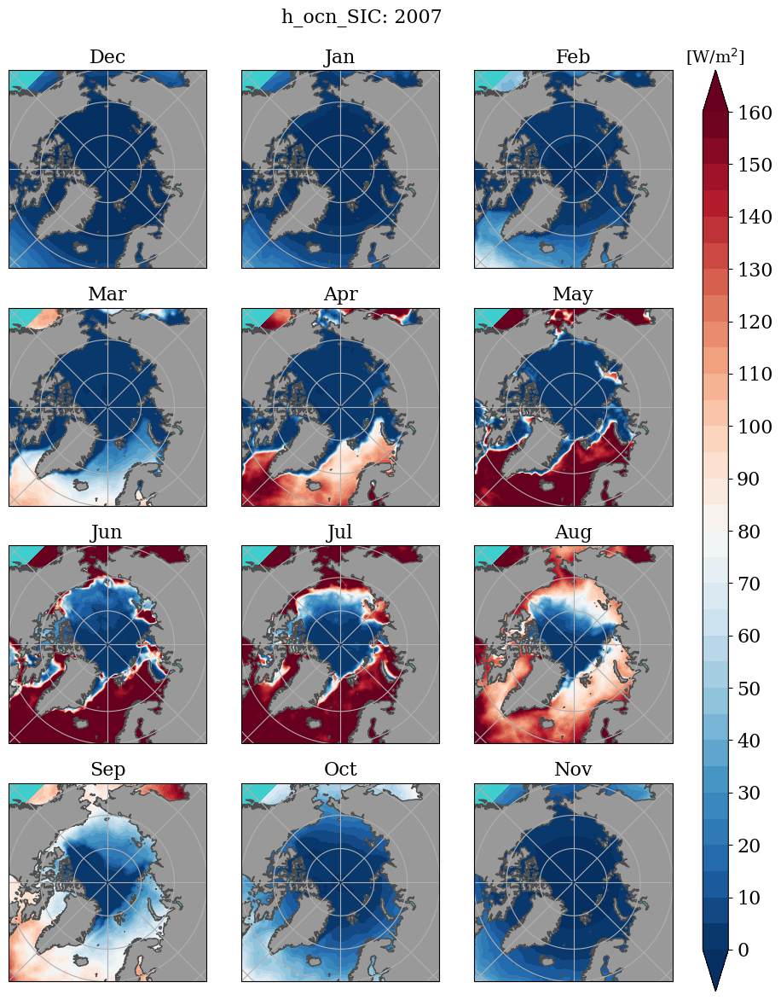

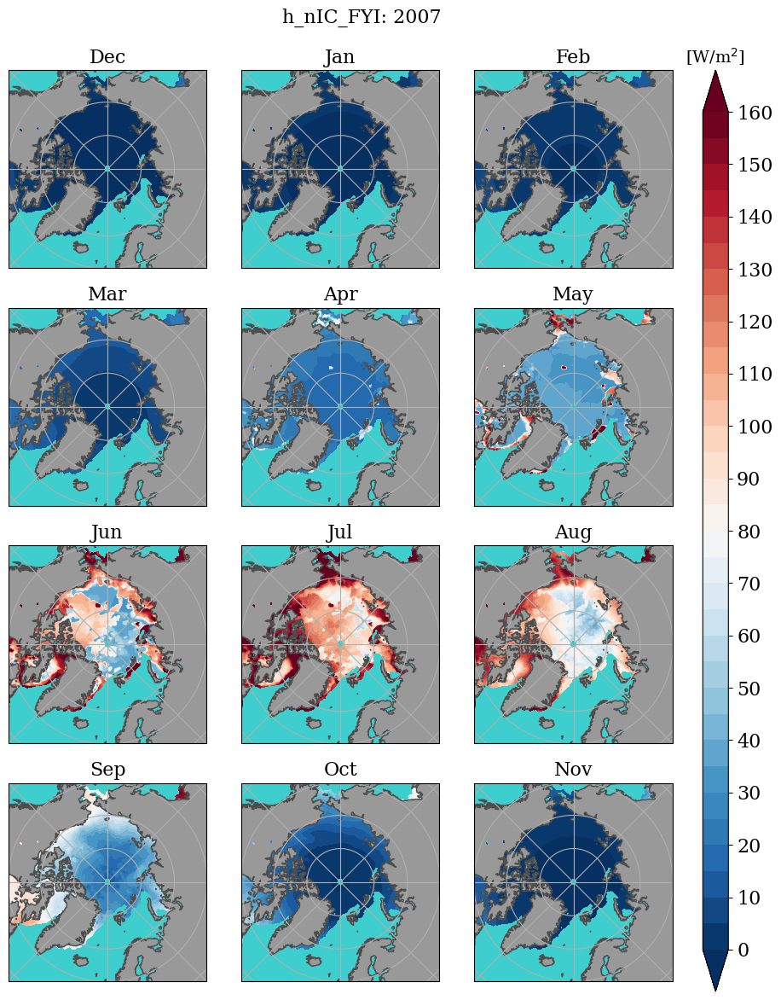

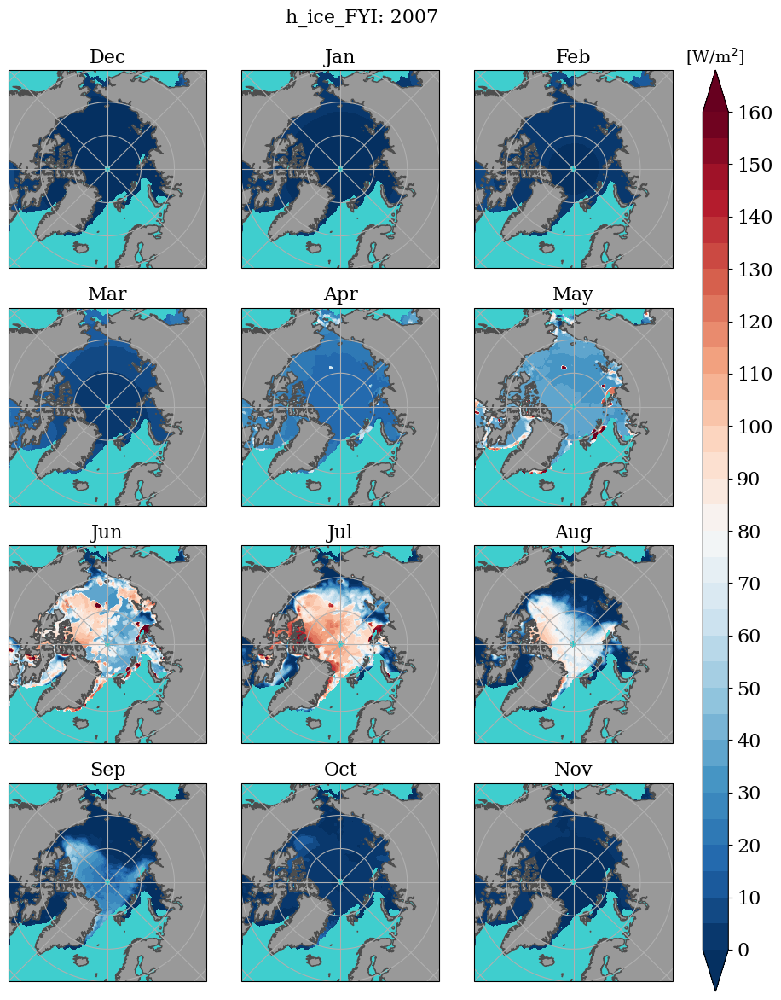

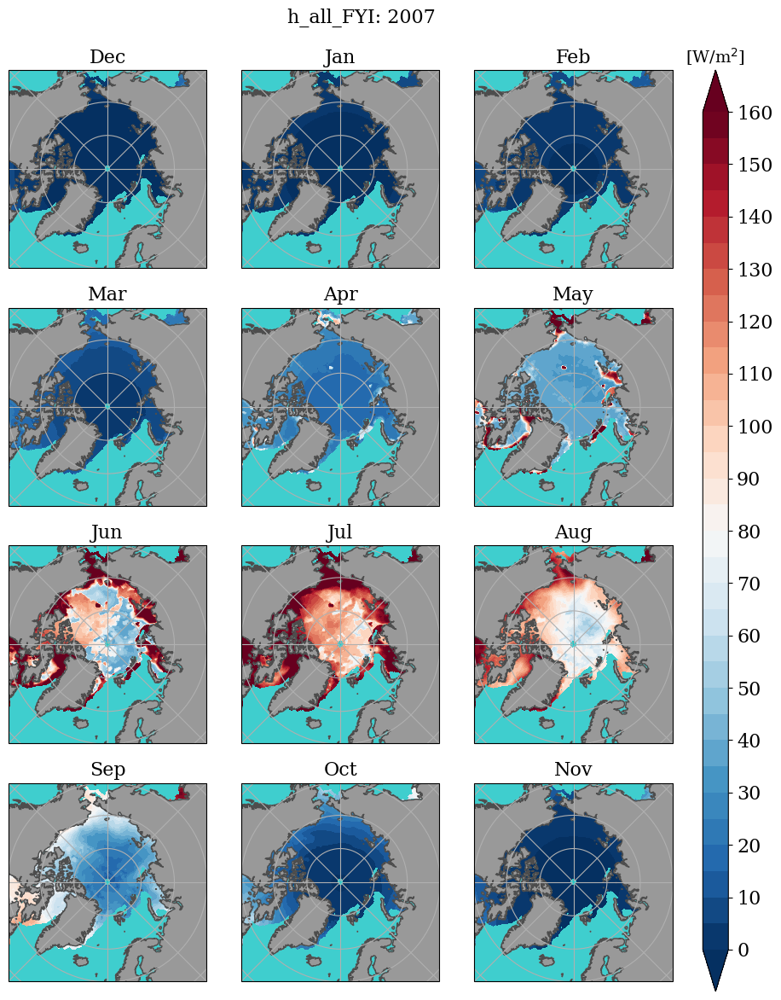

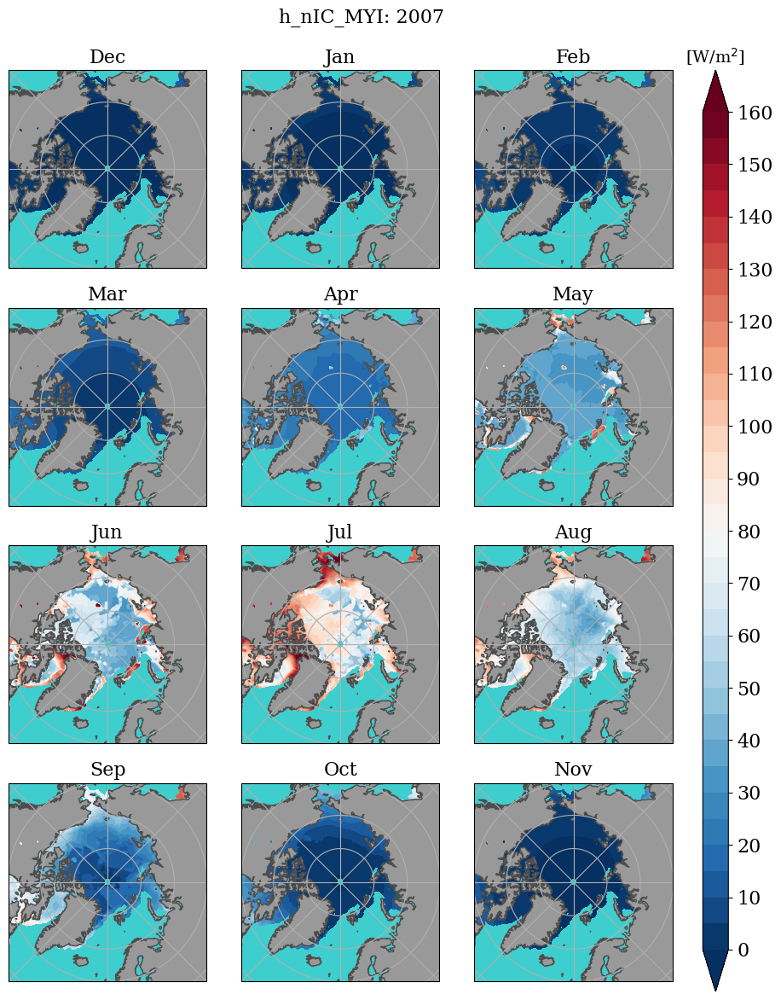

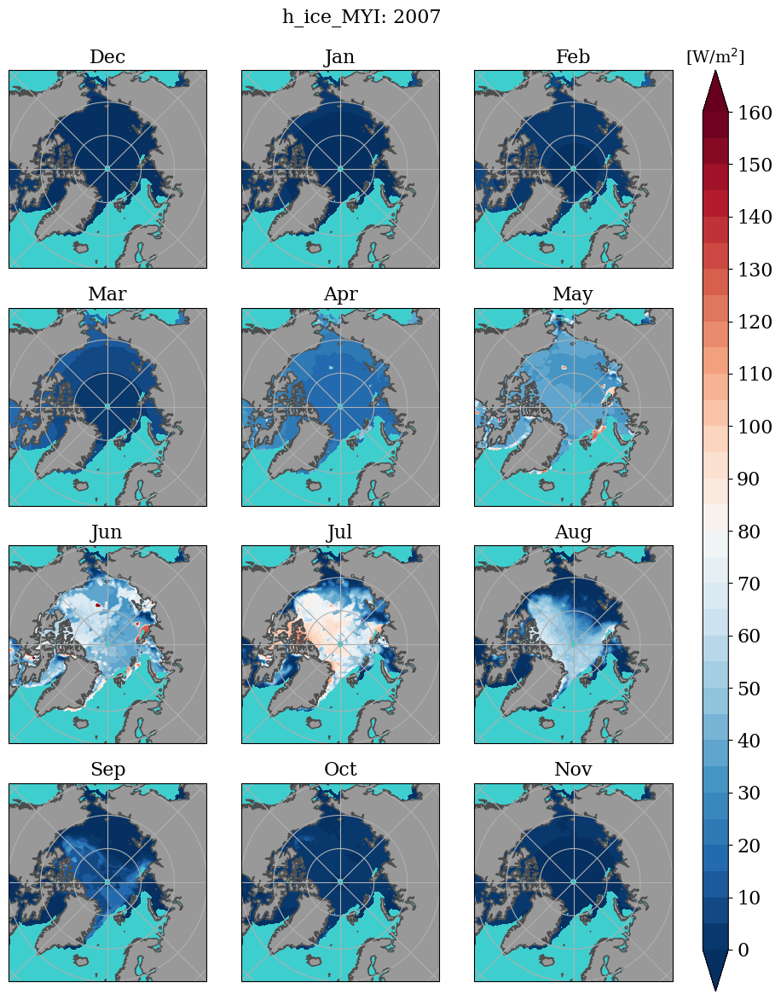

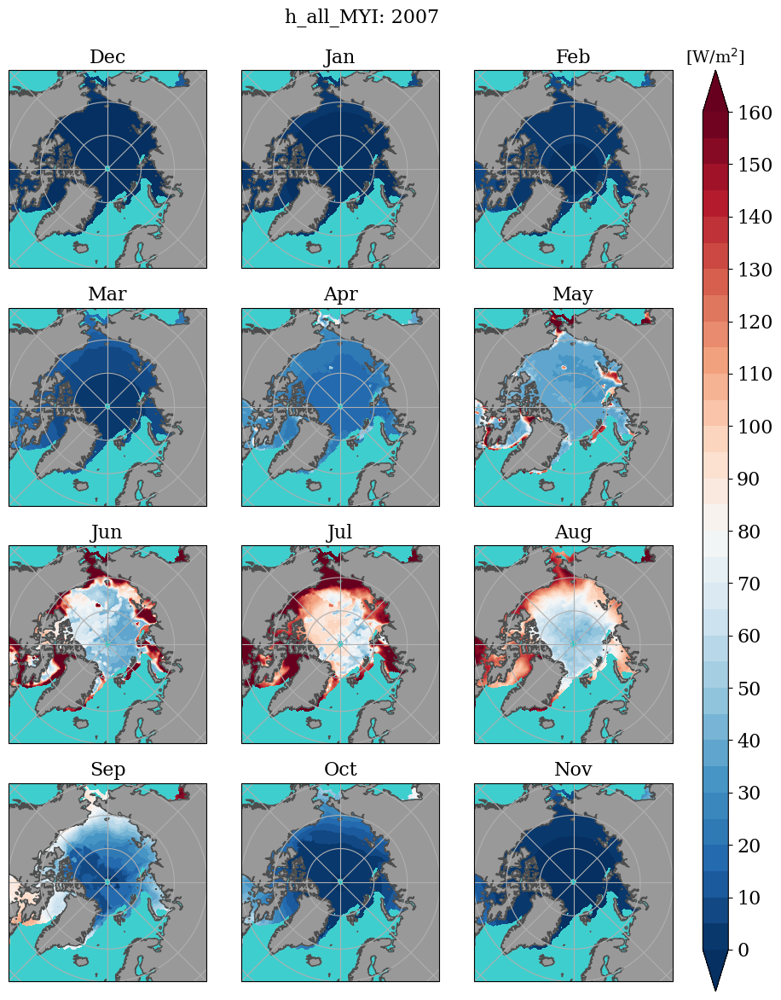

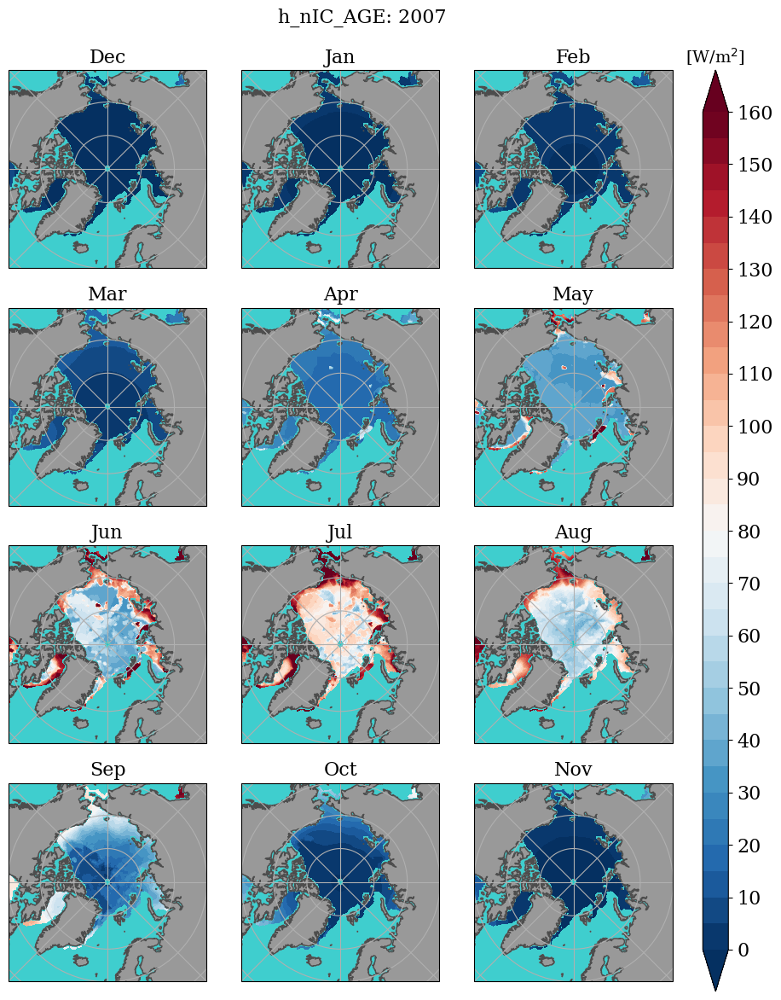

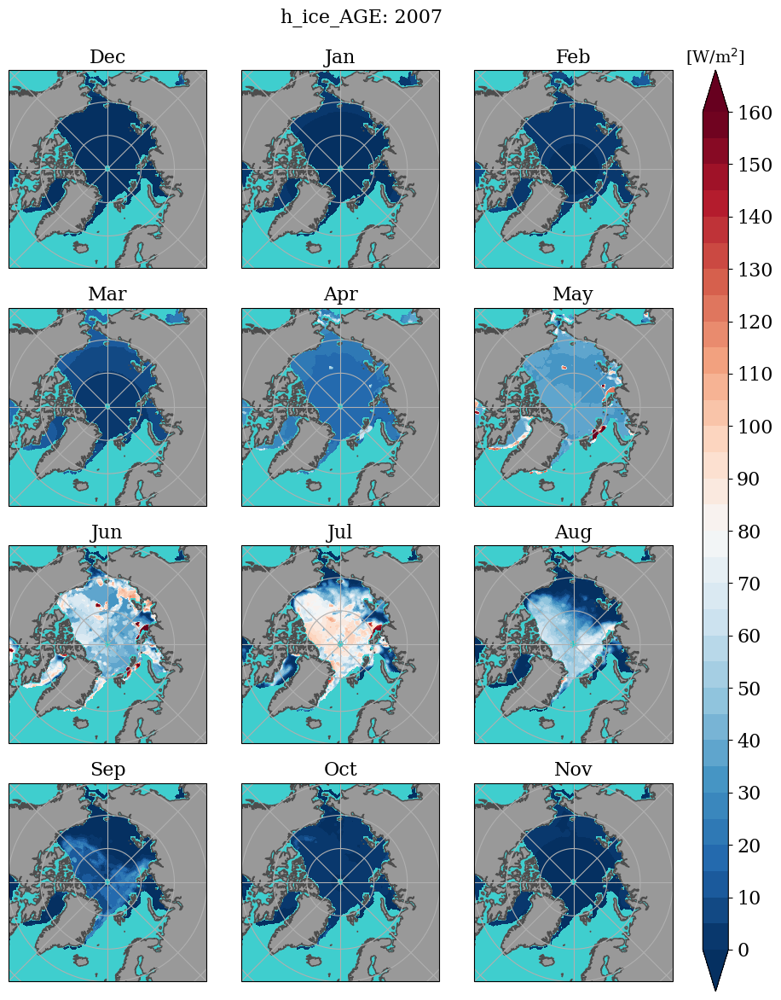

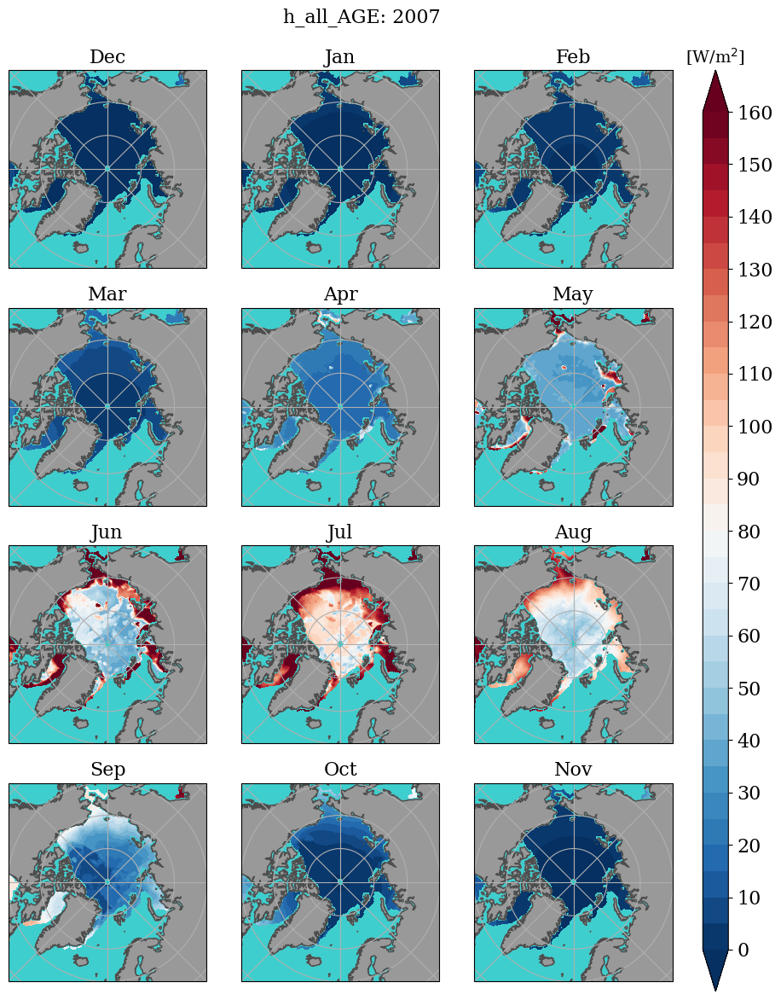

In [247]:
# --- plot heat flux using different albedo
for vn in [
    'h_ocn_SIC','h_nIC_FYI','h_ice_FYI','h_all_FYI',
    'h_nIC_MYI','h_ice_MYI','h_all_MYI',
    'h_nIC_AGE','h_ice_AGE','h_all_AGE', ]:
    fig, axs, chdls = plot_heat(vn)
    picfn = picdir/f'{vn}_{yr_txt}.{picfmt}'
    fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

In [262]:
def plot_acch(vn,lvl_acch=np.linspace(0,1000,41),cticks=np.linspace(0,1000,11)):
    chdls = []
    fig, axs = plt.subplots(4,3,figsize=(10,12),subplot_kw=dict(projection=boprj),sharex=True,sharey=True)
    for ii,i_mon in enumerate([11]+list(range(11))):
        irow = ii//3
        icol = ii%3
        txt_mon = mon_names[i_mon]
        ax = axs[irow,icol]
        dat_mon = dat07mon[vn][i_mon]
        chdl,_,_=plot2d(dat_mon,fig=fig,ax=ax,mds=mds,prj_in=boprj,lvl_in=lvl_acch)
        chdls.append(chdl)
        ax.set_title(f'{txt_mon}',fontsize=ftsz)

    fig.subplots_adjust(wspace=-.1,hspace=.2,top=.92,bottom=.03,left=.05,right=.90)
    cax = fig.add_axes([.9,.02,.03,.9])
    cb = fig.colorbar(chdls[0],ax=ax,cax=cax)
    cb.ax.set_title(r'[MJ]',fontsize=ftsz-2)
    cb.set_ticks(cticks)
    fig.suptitle(f'{vn}: {dat07.year}',fontsize=ftsz);
    return fig, axs, chdls

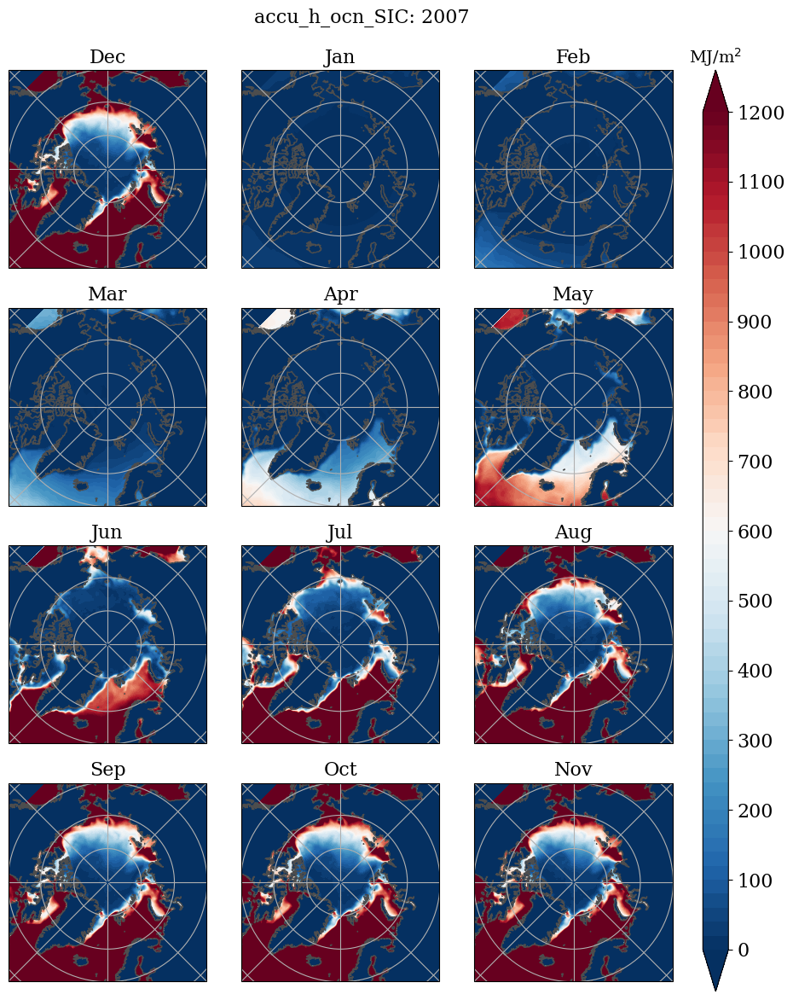

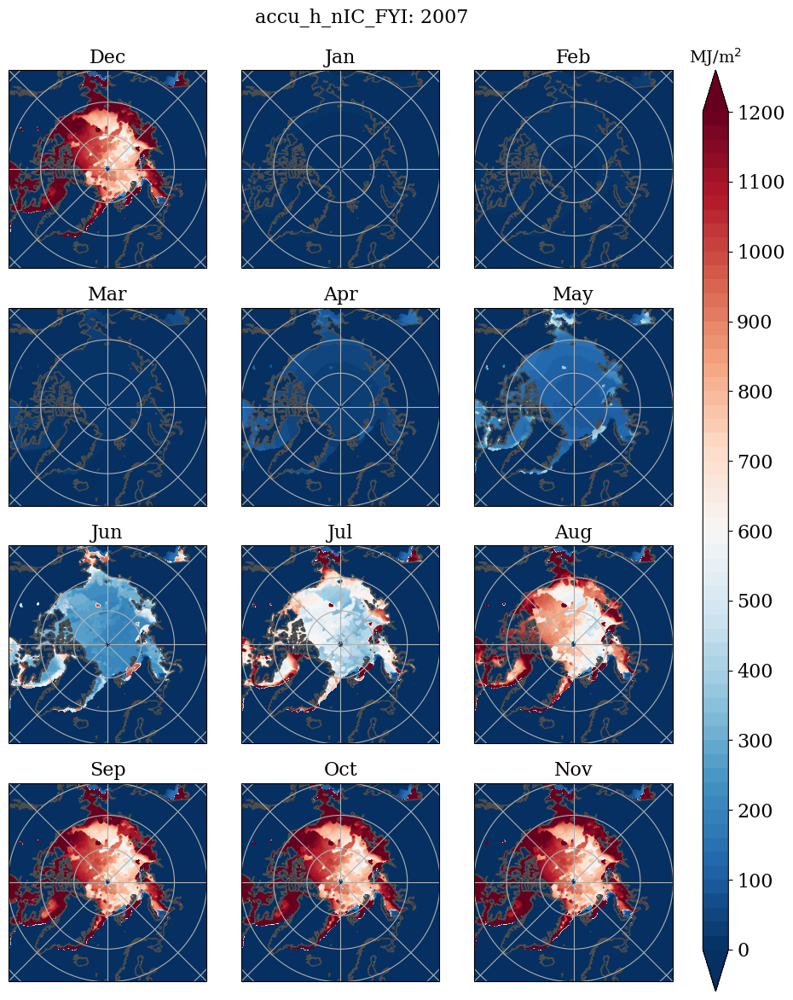

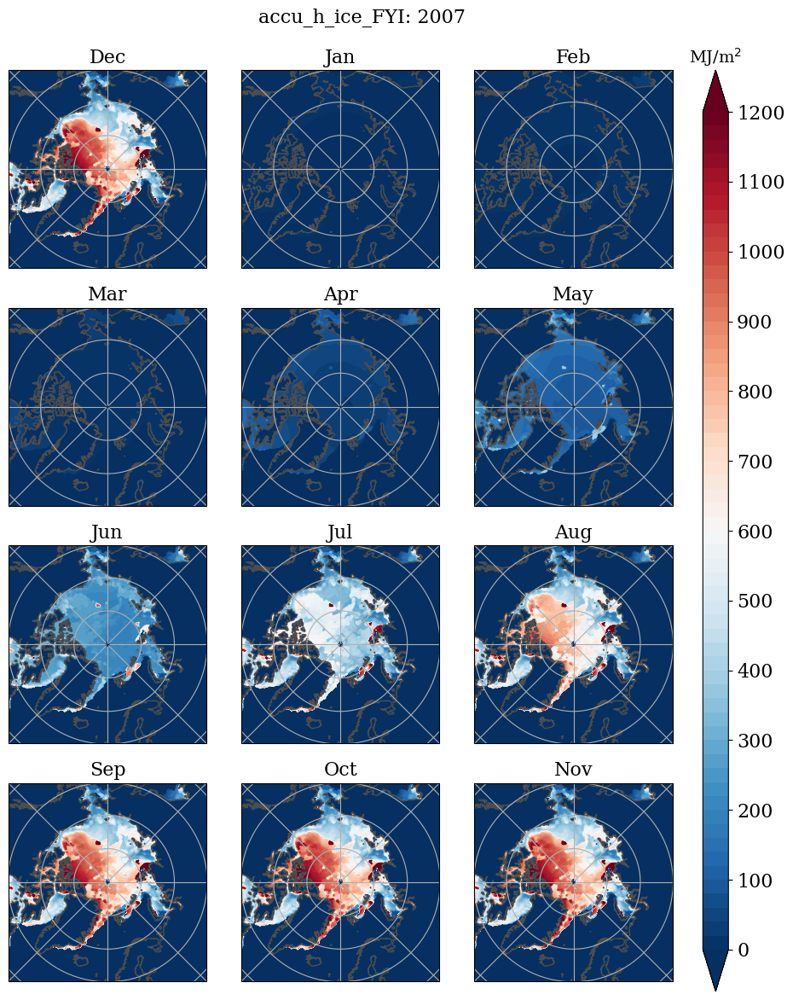

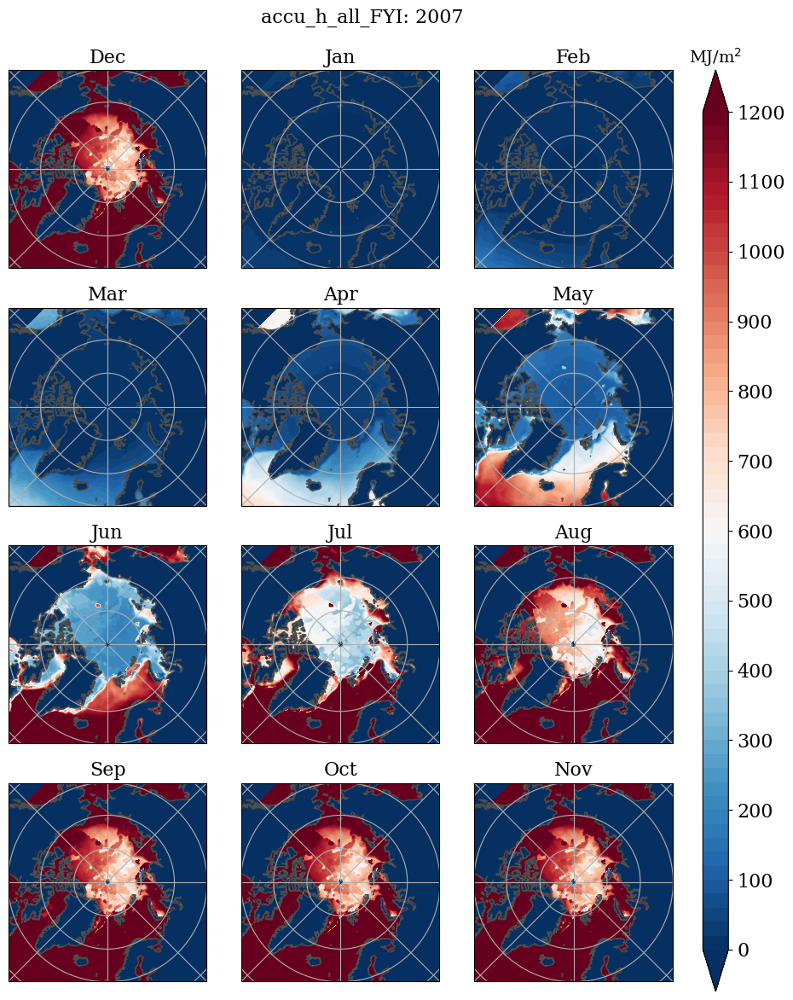

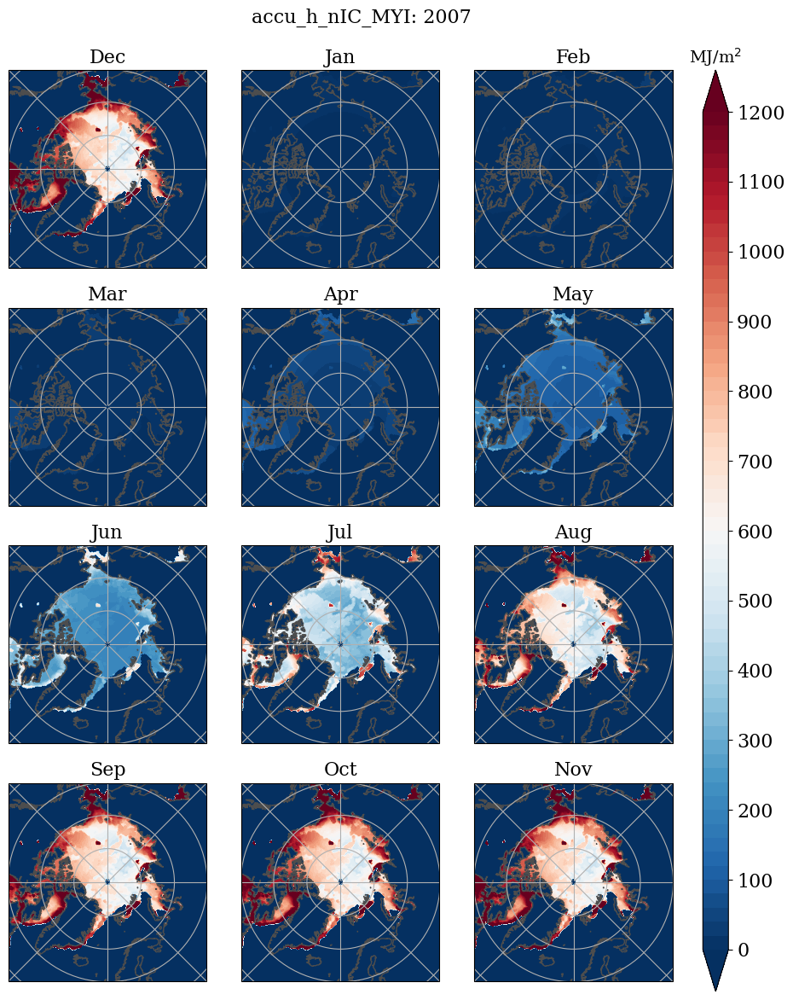

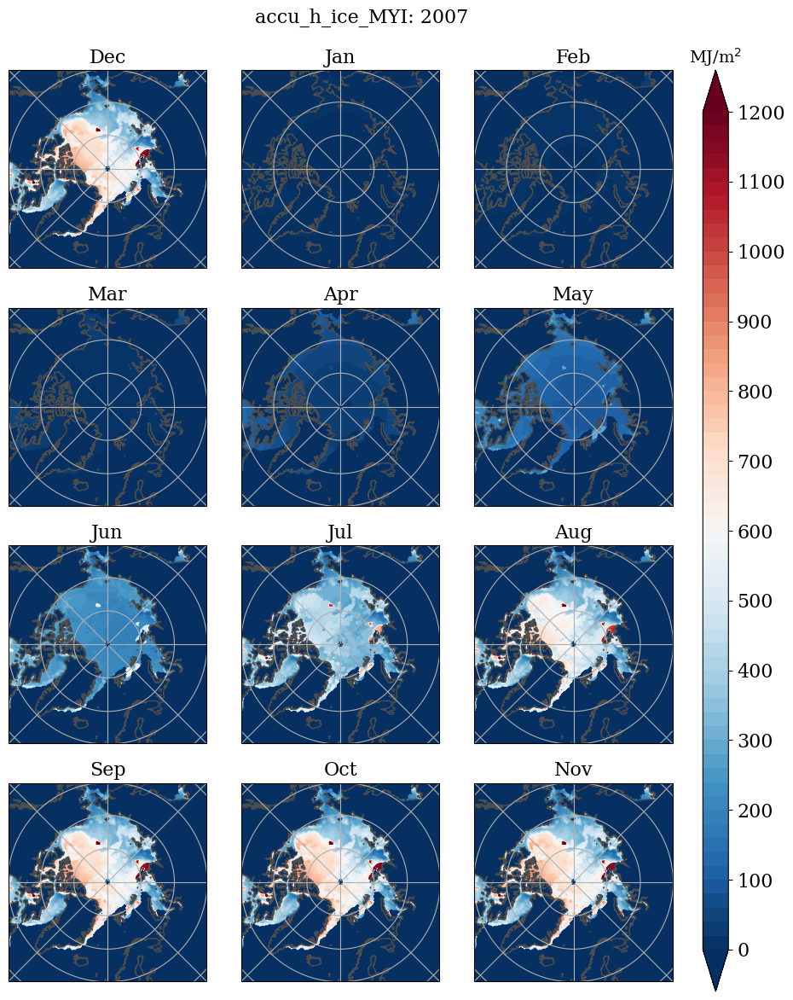

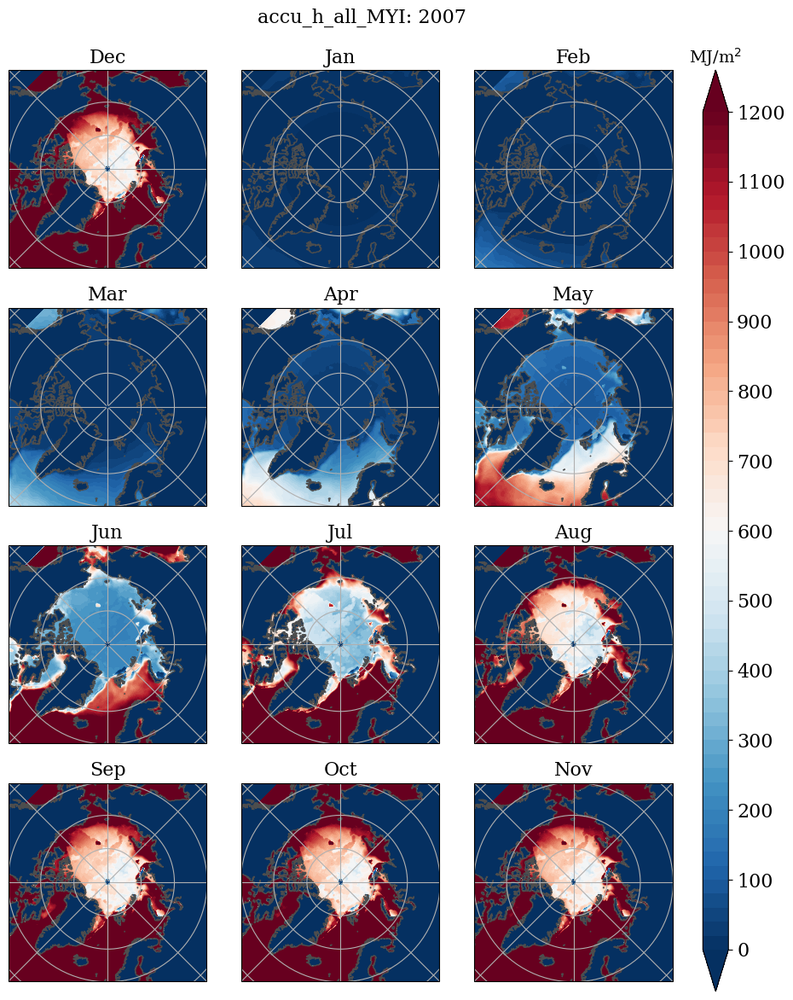

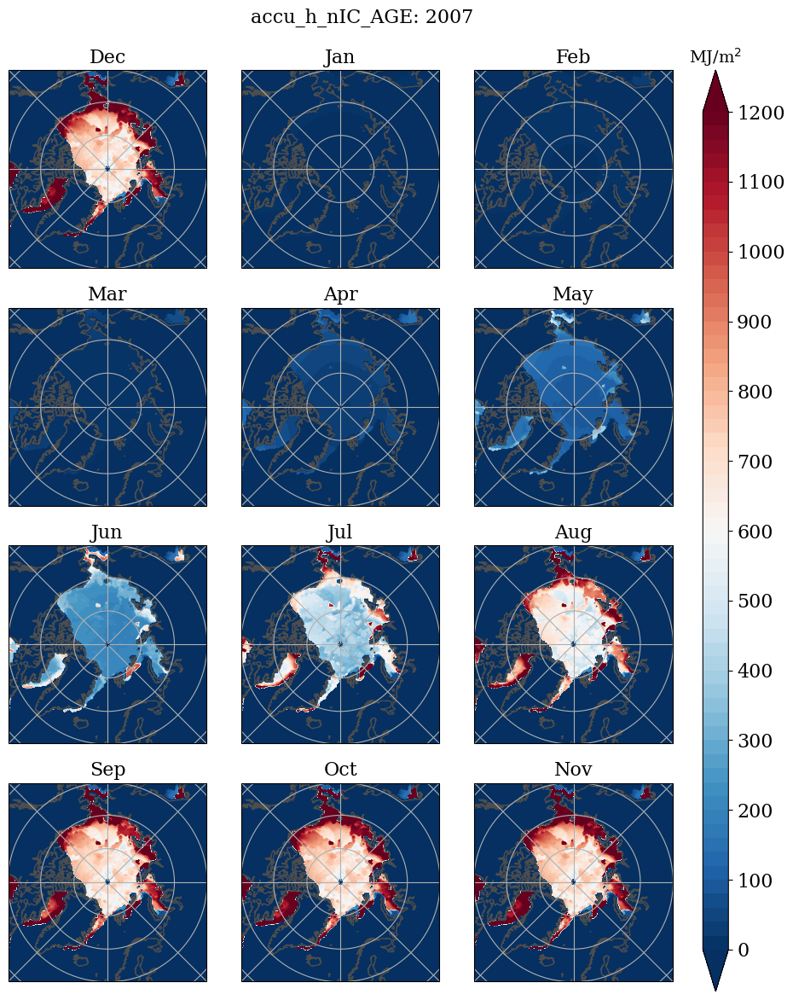

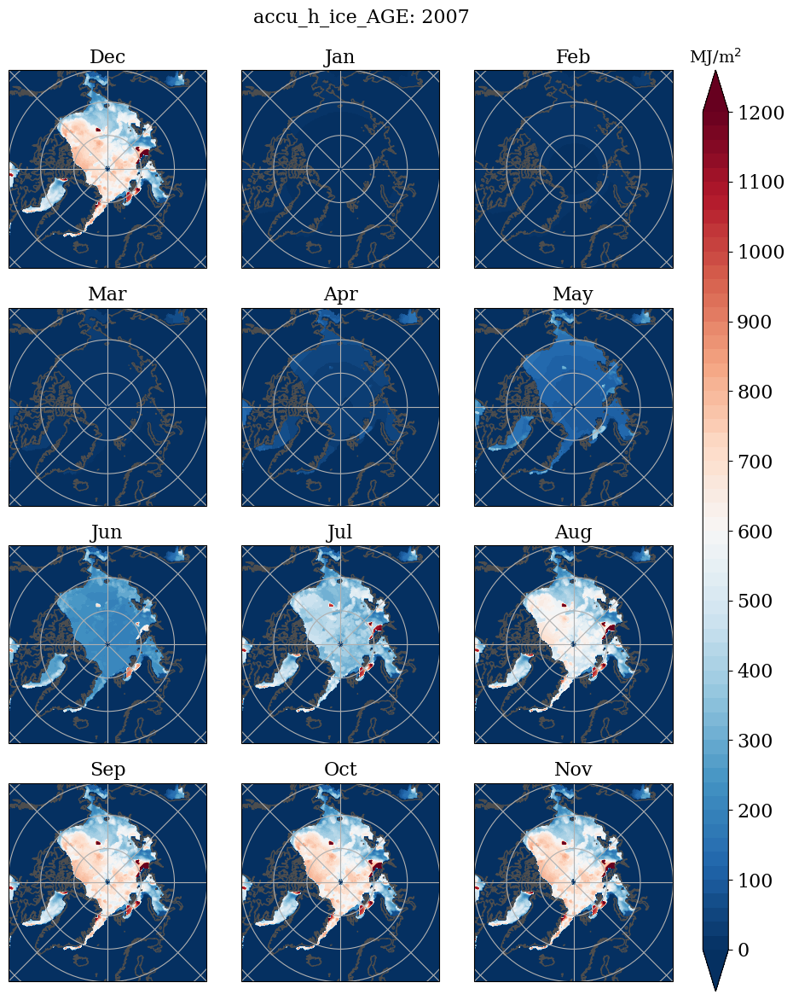

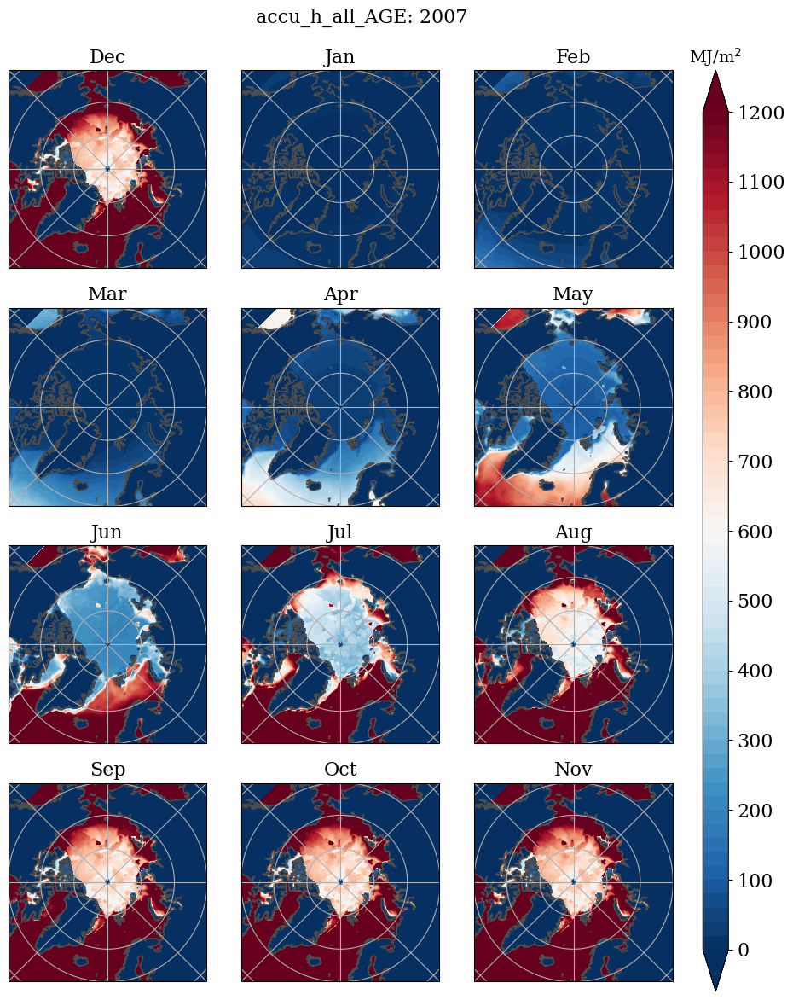

In [361]:
# --- plot accumulated heat flux with different albedo ---
for vn_core in [
    'h_ocn_SIC','h_nIC_FYI','h_ice_FYI','h_all_FYI',
    'h_nIC_MYI','h_ice_MYI','h_all_MYI',
    'h_nIC_AGE','h_ice_AGE','h_all_AGE',]:
    vn = f'accu_{vn_core}'
    fig, axs, chdls = plot_heat(vn,lvl_heat=np.linspace(0,1200,61),cticks=np.linspace(0,1200,13),txt_unit=r'MJ/m$^2$')
    picfn = picdir/f'{vn}_{yr_txt}.{picfmt}'
    fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')

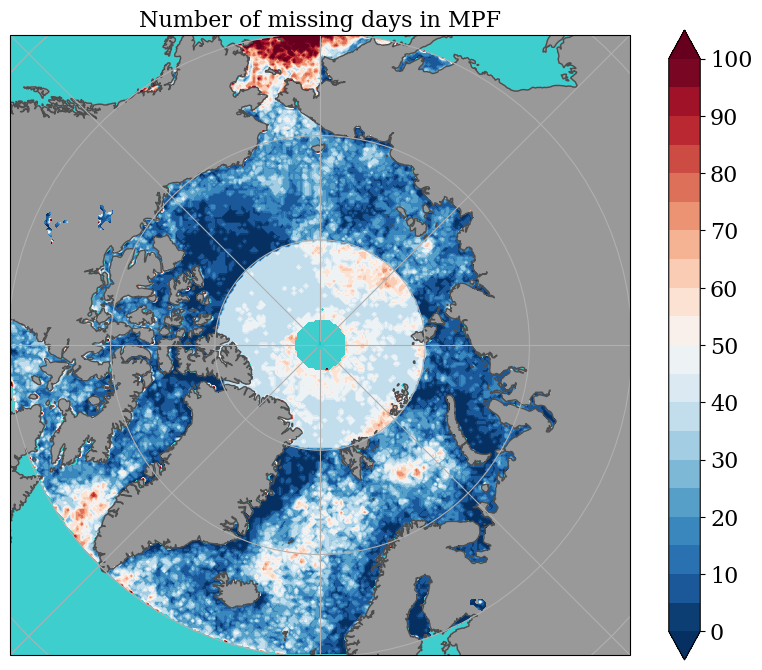

In [387]:
nmiss = dat07.data['mpf'].isnull().sum(dim='time')
nmiss = nmiss.where(nmiss!=128,np.nan)
fig, ax = plt.subplots(1,1,figsize=(10,10),subplot_kw=dict(projection=boprj))
chdl, fig, ax = plot2d(nmiss,lvl_in=np.linspace(0,100,21),fig=fig,ax=ax)
cb = fig.colorbar(chdl,ax=ax,shrink=.75)
cb.set_ticks(np.linspace(0,100,11))
ax.set_title('Number of missing days in MPF',fontsize=ftsz)
fig.subplots_adjust(top=.95)
picfn = picdir/f'n_miss_mpf.{picfmt}'
fig.savefig(picfn,format=picfmt,dpi=picdpi,bbox_inches='tight')


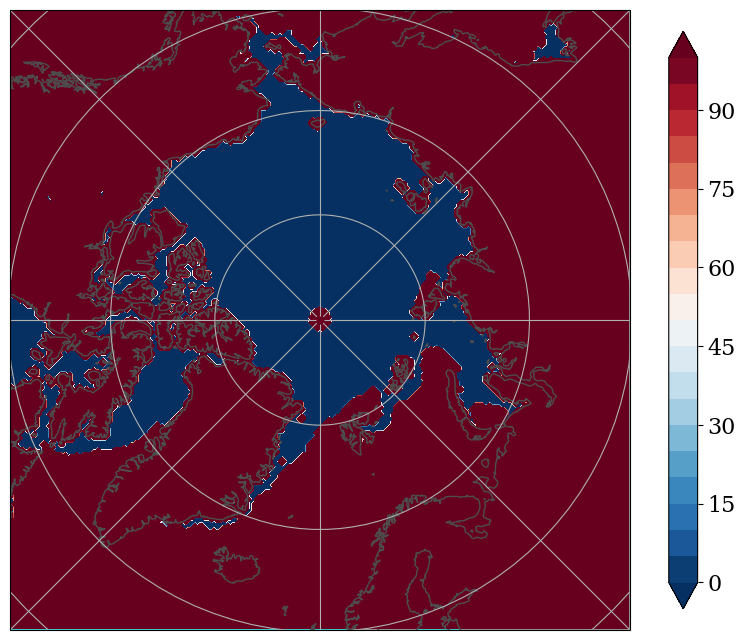

In [420]:
datmiss = dat07.data['alb_MYI'].isnull().sum(dim='time')
#nmiss = nmiss.where(nmiss!=128,np.nan)
fig, ax = plt.subplots(1,1,figsize=(10,10),subplot_kw=dict(projection=boprj))
chdl, fig, ax = plot2d(datmiss,lvl_in=np.linspace(0,100,21),fig=fig,ax=ax)
cb = fig.colorbar(chdl,ax=ax,shrink=.75)